# Basic RNA analysis

In [355]:
import sys,os
import numpy as np, matplotlib.pyplot as plt
import numpy
import pickle
import imp
import glob
from PIL import Image
import tifffile
from tqdm import tqdm_notebook as tqdm

def sl_to_um(sls,pix=[0.25,0.10833,0.10833]):
    return np.array([(sl.start+sl.stop)/2. for sl in sls])*pix
def get_fov(fl):
    return int(os.path.basename(fl).split('--')[0].split('_')[-1])
def fl_to_gnQtag(fl,tag='Q'):
    return [tag+e for e in os.path.basename(fl).split('--')[1].split(tag)[-1].split('_')]

def non_intersecting_cells(Xs,ifovs,vols,pos_fovs, dist_th = 7, approx_half_fov =100):
    from scipy.spatial.distance import pdist,squareform,cdist
    Mat_fov = squareform(pdist(pos_fovs))
    lfov = np.min(Mat_fov[Mat_fov>approx_half_fov])
    th_dist_fov = 1.5*lfov
    pair_fovs = []
    for ifov in range(len(Mat_fov)):
        for jfov in range(ifov):

            if Mat_fov[ifov,jfov]<th_dist_fov:
                pair_fovs.append((ifov,jfov))
    
    bad = []
    icells_ = np.arange(len(Xs))
    for ifov,jfov in pair_fovs:
        keepi = np.where(ifovs==ifov)[0]
        keepj = np.where(ifovs==jfov)[0]
        M_ = cdist(Xs[keepi],Xs[keepj])
        if np.prod(M_.shape)>0:
            imins = np.argmin(M_,axis=0)
            jmins = np.arange(len(imins))
            dist = M_[imins,jmins]<dist_th

            #jmins,imins = np.where(M_<dist_th)
            ki = icells_[keepi[imins[dist]]]#&(dist<dist_th)]]
            kj = icells_[keepj[jmins[dist]]]#&(dist<dist_th)]]
            #dif = Xs[ki]-Xs[kj]
            #dists_ = np.median(np.linalg.norm(dif-np.median(dif,axis=0),axis=-1))
            #print(dists_)
            bad.extend(ki[vols[ki]<vols[kj]])
            bad.extend(kj[vols[kj]<vols[ki]])
    
    return np.setdiff1d(icells_,bad)
class RNA_analyzer():
    def __init__(self,save_fld = r'\\BBFISH1\Raw_data_1\Glass_MERFISH\CGBB_1_25_2022_Analysis_v4',
                 tag_file_sets = ['*--dic_pts_cell_v2.pkl'],
                 tag_first_file_set = '*Q1,*--dic_pts_cell_v2.pkl',
                pos_fl = r'\\BBFISH1\Raw_data_1\Glass_MERFISH\CGBB_1_25_2022\pos.txt',
                pix = [0.25,0.10833,0.10833],
                vol_th=200000,ncol=3):
        self.save_fld = save_fld
        self.pix = pix
        self.vol_th = vol_th
        ###----get a set of RNA files
        
        self.fls_single_hybe_ = np.array([fl for fl in glob.glob(self.save_fld+os.sep+tag_first_file_set)])
        self.fls_ = np.array([fl for tag_file_set in tag_file_sets for fl in glob.glob(self.save_fld+os.sep+tag_file_set)] )
        print("Found number of RNA analysis files (for one hybe) (fls_single_hybe_):"+str(len(self.fls_single_hybe_)))
        print("Found total number of RNA analysis files (fls_):"+str(len(self.fls_)))
        
        ifovs_fls = [get_fov(fl) for fl in self.fls_]
        ifovs_u,cts = np.unique(ifovs_fls,return_counts=True)
        self.nhybes = np.max(cts)
        ifovs_complete = ifovs_u[cts==self.nhybes]
        self.ifovs_complete = ifovs_complete
        self.fls = self.fls_[np.in1d(ifovs_fls,ifovs_complete)]
        
        ifovs_fls = [get_fov(fl) for fl in self.fls_single_hybe_]
        self.fls_single_hybe = self.fls_single_hybe_[np.in1d(ifovs_fls,ifovs_complete)]
        print("Found number of hybes: "+str(self.nhybes))
        print("Found number of complete fovs: "+str(len(ifovs_complete)))
        print("Found number of complete RNA analysis files (for one hybe) (fls_single_hybe):"+str(len(self.fls_single_hybe)))
        print("Found total number of RNA analysis files (fls):"+str(len(self.fls)))
        
        ###----laod the positions
        self.pos_fovs = np.array([ln[:-1].split(',') for ln in 
          open(pos_fl,'r') if len(ln)>2],dtype=float)
        self.pos_fovs = self.pos_fovs[:,::-1]*[1,-1] #----microscope specific transformations
        self.ncol=ncol
    def cells_to_Xs_vols_ifovs(self,icol=0):
        vol_th=self.vol_th
        pos_fovs = self.pos_fovs
        fls = self.fls_single_hybe
        
        Xs,vols,ifovs,icells,bs = [],[],[],[],[]
        self.dic_cells_RNA = {}
        for fl in tqdm(fls):
            dic_drft,dic_fits,_,_ = pickle.load(open(fl,'rb'))
            dic_fts_col = dic_fits[icol]
            ifov = get_fov(fl)
            Tref = dic_drft['Ds'][0]
            ifov = get_fov(fl)
            
            X = np.array([sl_to_um(dic_fts_col[cell]['slice'],self.pix) for cell in dic_fts_col 
                          if dic_fts_col[cell]['volume']>vol_th])
            b = np.array([len(dic_fts_col[cell]['fits']) for cell in dic_fts_col 
                          if dic_fts_col[cell]['volume']>vol_th])
            vol = np.array([dic_fts_col[cell]['volume'] for cell in dic_fts_col 
                            if dic_fts_col[cell]['volume']>vol_th])
            icell_ = [cell+ifov*10**4 for cell in dic_fts_col if dic_fts_col[cell]['volume']>vol_th]
            if len(X)>0:
                X[:,1:]+=pos_fovs[ifov]
                X+=[t if t>0 else 0 for t in Tref]

                icells.extend(icell_)
                Xs.extend(X)
                bs.extend(b)
                vols.extend(vol)
                ifovs.extend([ifov]*len(X))
            
        Xs = np.array(Xs)
        bs=np.array(bs)
        vols=np.array(vols)
        ifovs = np.array(ifovs)
        icells = np.array(icells)
        
        bs_ = bs/vols*np.median(vols)
        
        
        self.dic_cells_RNA = {icell:{'ifov':ifov,'volume':vol,'X':X} for (icell,X,ifov,vol) in zip(icells,Xs,ifovs,vols)}
        self.Xs,self.icells,self.ifovs,self.bs,self.bs_,self.vols = Xs,icells,ifovs,bs,bs,vols
    def filter_overlapping_cells(self,dist_th = 7, approx_half_fov =100,plt_val=False):
        icells_keep = non_intersecting_cells(self.Xs,self.ifovs,self.vols,self.pos_fovs, dist_th = dist_th, approx_half_fov =approx_half_fov)
        self.icells_keep = self.icells[icells_keep]
        self.dic_cells_final = {icell:self.dic_cells_RNA[icell] for icell in self.dic_cells_RNA if icell in self.icells_keep}

        if plt_val:
            plt.figure(figsize=(20,20))
            Xs = np.array([self.dic_cells_final[icell]['X'] for icell in  self.dic_cells_final])
            plt.plot(Xs[:,1],Xs[:,2],'.',markersize=1)

            Xs = np.array([self.dic_cells_RNA[icell]['X'] for icell in  self.dic_cells_RNA 
                           if icell not in rna_.dic_cells_final])
            plt.plot(Xs[:,1],Xs[:,2],'rx')

            Xs = np.array(self.pos_fovs)
            #plt.plot(Xs[:,0],Xs[:,1],'.',color='gray')
            for ifv,X in enumerate(Xs):
                plt.text(X[0],X[1],str(ifv))
            plt.axis('equal')
        
    def load_all_files(self,bad_fovs=[]):
        self.dic_col = {}
        self.bad_fovs = bad_fovs
        self.th_med_dic = {}
        self.dic_drfts = []
        for fl in tqdm(self.fls):
            ifov = get_fov(fl)
            if ifov not in bad_fovs:
                dic_drft,dic_fits,ths_,meds_ = pickle.load(open(fl,'rb'))
                self.dic_drfts.append(dic_drft)
                tags = fl_to_gnQtag(fl)
                for icol in dic_fits:
                    if icol<len(tags):
                        dic_fts_col = dic_fits[icol]
                        Q_tag = tags[icol]
                        self.dic_col[Q_tag]=icol
                        if Q_tag not in self.th_med_dic: self.th_med_dic[Q_tag]={}
                        self.th_med_dic[Q_tag][ifov]=[ths_[icol],meds_[icol]]
                        for cell in dic_fts_col:
                            cell_ = ifov*10**4+cell
                            if cell_ in self.dic_cells_final:
                                self.dic_cells_final[cell_][tags[icol]]=dic_fts_col[cell]['fits']
    def get_dic_count(self,re_th=1.35,tags = ['Q','I','G']):
        dic_cells_final = self.dic_cells_final
        Qs = np.unique([key for cell in dic_cells_final for key in dic_cells_final[cell].keys() if np.any([tg in key for tg in tags])])
        dic_count = {}
        for gene in Qs:
            th_com,med_com = np.median([self.th_med_dic[gene][fov] for fov in self.th_med_dic[gene]],axis=0)
            dic_cells_final = self.dic_cells_final
            for cell in dic_cells_final:
                fits = dic_cells_final[cell].get(gene,[])
                if cell not in dic_count: dic_count[cell] = {}
                dic_count[cell][gene]=0
                if len(fits)>0:
                    hs = fits[:,0]
                    #dic_count[cell][gene] = np.sum(hs>th_com)
                    dic_count[cell][gene] = np.sum(hs>((th_com-med_com)*re_th+med_com))
        self.dic_count=dic_count
        
    def plot_gene_expression(self,gene,bad_cells=[],vmax=None,vmax_perc=None,name=None):
        dic_count = self.dic_count
        dic_cells_final = self.dic_cells_final
        cells = list(dic_count.keys())
        cells = [cell for cell in cells if ((int(cell)//10**4 not in self.bad_fovs) and (cell not in bad_cells))]
        scores = [dic_count[cell][gene] for cell in cells]
        x,y = -np.array([dic_cells_final[cell]['X'][1:] for cell in cells]).T


        fig = plt.figure(figsize=(15,12), facecolor='black')
        if vmax is None and vmax_perc is None:
            vmax_ = 30
        if vmax_perc is not None:
            vmax_ = np.percentile(scores, vmax_perc)
        if vmax is not None:
            vmax_ = vmax

        plt.scatter(x, y, c=scores, s=2, cmap='coolwarm', vmax=vmax_)
        cb = plt.colorbar(shrink=0.5)
        if name is None:
            name = gene
        cb.ax.set_title(f'{name}\ncounts', color='white', fontsize='x-large', fontweight='heavy')
        cb.ax.yaxis.set_tick_params(color='black')
        cb.outline.set_edgecolor('w')
        plt.setp(plt.getp(cb.ax.axes, 'yticklabels'), color='white', fontsize='x-large', fontweight='heavy')
        plt.grid(b=None)
        plt.axis('off')
        plt.axis('equal')
        plt.tight_layout()
        plt.show()
    def nan_dic_count_bad_drift_old(self,th_dist=2):
        bad_fls = np.array(self.fls)[np.where(~np.all(np.array([dic_drft['DEs'][0] 
                                    for dic_drft in  self.dic_drfts])<th_dist,axis=-1))[0]]
        
        bad_fls = np.array(self.fls)[np.where(np.array([len(dic_drft['D_pairs'][0][0]) 
                                    for dic_drft in  self.dic_drfts])<th_dist)[0]]
        
        
        print("Found the following files to have lost drift: "+str(bad_fls))
        dic_count = self.dic_count
        for fl in bad_fls:
            for cell in dic_count:
                fov = cell%10**4
                if get_fov(fl)==fov:
                    qs = fl_to_gnQtag(fl)
                    for q in qs:
                        dic_count[cell][q]=np.nan
        self.bad_fls = bad_fls
        
        
        
    def nan_dic_count_bad_drift(self,th_dist=2,npairs=None,correct=True):

        fls = [fl for fl in self.fls if get_fov(fl) not in self.bad_fovs]
        bad_fls = np.array(fls)[np.where(~np.all(np.array([dic_drft['DEs'][0] 
                                    for dic_drft in  self.dic_drfts])<th_dist,axis=-1))[0]]

        if npairs is not None: 
            bad_fls = np.array(fls)[np.where(np.array([len(dic_drft['D_pairs'][0][0]) 
                                        for dic_drft in  self.dic_drfts])<npairs)[0]]


        print("Found the following files to have lost drift: "+str(bad_fls))
        dic_count = self.dic_count
        for fl in bad_fls:
            for cell in dic_count:
                fov = cell//10**4
                if get_fov(fl)==fov:
                    qs = fl_to_gnQtag(fl)
                    for q in qs:
                        dic_count[cell]['Q'+q]=np.nan
                    #for q in dic_count[cell].keys():
                    #    dic_count[cell][q]=0
        self.bad_fls = bad_fls

        if correct:
            dic_count = self.dic_count
            print("Correcting the cells in those fovs...")
            cells = list(dic_count.keys())
            cell = cells[0]
            qs = list(dic_count[cell].keys())
            X = np.array([[dic_count[cell][q] for q in qs]for cell in cells])
            bad_ = np.any(np.isnan(X),axis=1)
            cells_bad = np.where(bad_)[0]
            cells_good = np.where(~bad_)[0]

            X_ = X#/np.nansum(X,axis=-1)[:,np.newaxis]
            X_bad_ = X_[cells_bad]
            X_good_ = X_[cells_good]
            best_cells = [np.argsort(np.nanmean(np.abs(X__-X_good_),axis=-1))[:10] for X__ in tqdm(X_bad_[:])]

            X_copy = X.copy()
            for ibad in range(len(best_cells)):   
                ibest = best_cells[ibad]
                where_bad = np.isnan(X_bad_[ibad])
                new_vals = np.nanmedian(X[cells_good][ibest][:,where_bad],axis=0)
                X_copy[cells_bad[ibad],where_bad] = new_vals
                #new_vals = np.nanmedian(X[cells_good][ibest][:,:],axis=0)
                #X_copy[cells_bad[ibad],:] = X[cells_good][ibest[0]]#new_vals
            #dic_count = self.dic_count
            for icell,cell in enumerate(cells):
                for iq,q in enumerate(qs):
                    dic_count[cell][q] = X_copy[icell,iq]

In [356]:
rna_ = RNA_analyzer(save_fld = r'\\MERFISH6.ucsd.edu\merfish6v2\DNA_FISH\20230122_R120PVTS32RDNA_Analysis',
                 tag_file_sets = ['*Q*--dic_pts_cell.pkl'],
                 tag_first_file_set = '*Q1_*--dic_pts_cell.pkl',
                pos_fl = r'\\MERFISH6.ucsd.edu\merfish6v2\DNA_FISH\20230122_R120PVTS32RDNA_Analysis\posDNA.txt',
                pix = [0.25,0.10833,0.10833],
                vol_th=200000,ncol=3)

#th_col = (self.th_fits[icol]-self.med_fits[icol])*th_+self.med_fits[icol]

Found number of RNA analysis files (for one hybe) (fls_single_hybe_):125
Found total number of RNA analysis files (fls_):1750
Found number of hybes: 14
Found number of complete fovs: 125
Found number of complete RNA analysis files (for one hybe) (fls_single_hybe):125
Found total number of RNA analysis files (fls):1750


In [357]:
ifovs_complete = rna_.ifovs_complete
nmax = np.max(ifovs_complete)
np.setdiff1d(np.arange(nmax),ifovs_complete)

array([], dtype=int32)

In [358]:
rna_.cells_to_Xs_vols_ifovs()
#cells_to_Xs_vols_ifovs(rna_)

<ipython-input-355-e427cc571d02>:94: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls):


  0%|          | 0/125 [00:00<?, ?it/s]

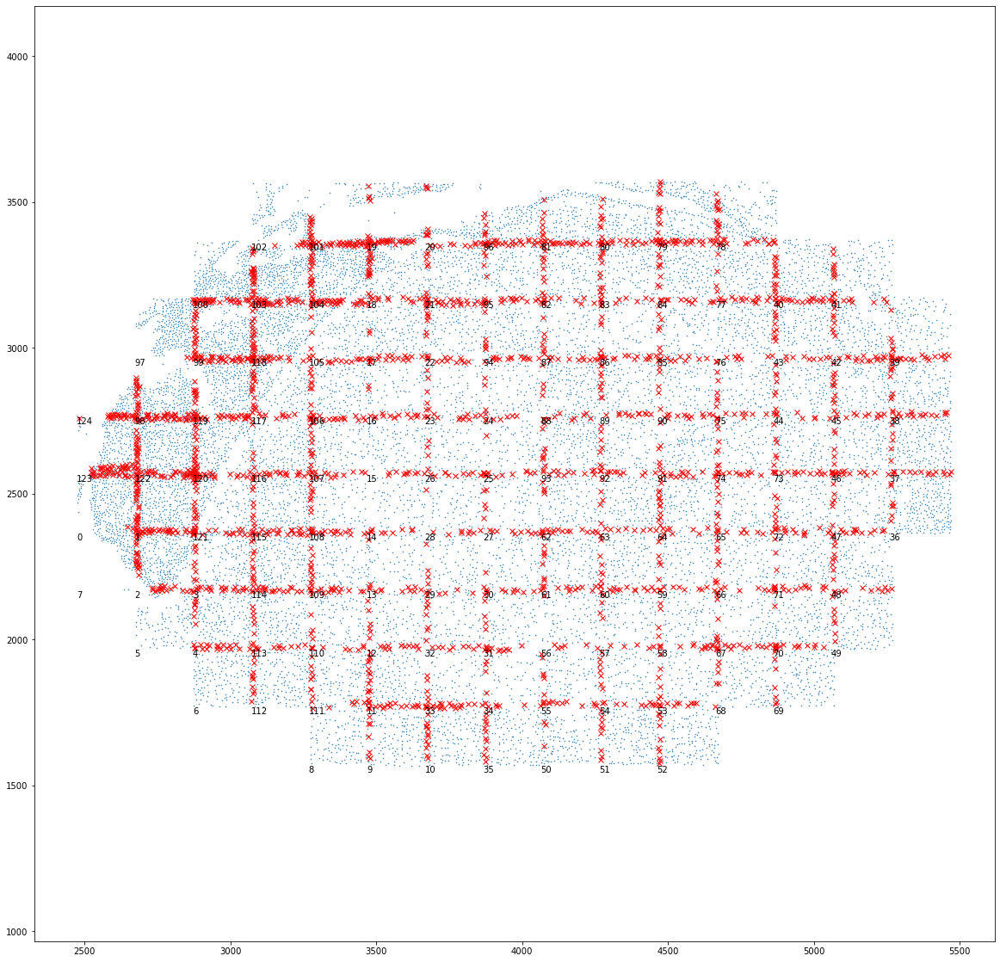

In [359]:
rna_.filter_overlapping_cells(dist_th = 7, approx_half_fov =100,plt_val=True)

In [360]:
rna_.load_all_files(bad_fovs = [])
#rna_.get_dic_count(re_th=1.)

<ipython-input-355-e427cc571d02>:154: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(self.fls):


  0%|          | 0/1750 [00:00<?, ?it/s]

In [361]:
#len(rna_.dic_count)

In [362]:
def get_dic_count(self,re_ths=[2.5,3,2.5],tags = ['Q']):
    dic_cells_final = self.dic_cells_final
    Qs = np.unique([key for cell in dic_cells_final for key in dic_cells_final[cell].keys() if np.any([tg==key[:len(tg)] for tg in tags])])
    dic_count = {}
    for gene in tqdm(Qs):
        th_com,med_com = np.median([self.th_med_dic[gene][fov] for fov in self.th_med_dic[gene]],axis=0)
        dic_cells_final = self.dic_cells_final
        for cell in dic_cells_final:
            fits = dic_cells_final[cell].get(gene,[])
            if cell not in dic_count: dic_count[cell] = {}
            dic_count[cell][gene]=0
            if len(fits)>0:
                hs = fits[:,0]
                #dic_count[cell][gene] = np.sum(hs>th_com)
                icol = rna_.dic_col[gene]
                re_th = re_ths[icol]
                dic_count[cell][gene] = np.sum(hs>((th_com-med_com)*re_th+med_com))
    self.dic_count=dic_count

In [363]:
get_dic_count(rna_,re_ths=[2.5,3,2.5],tags = ['Q'])

<ipython-input-362-1a1186dfd30b>:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for gene in tqdm(Qs):


  0%|          | 0/42 [00:00<?, ?it/s]

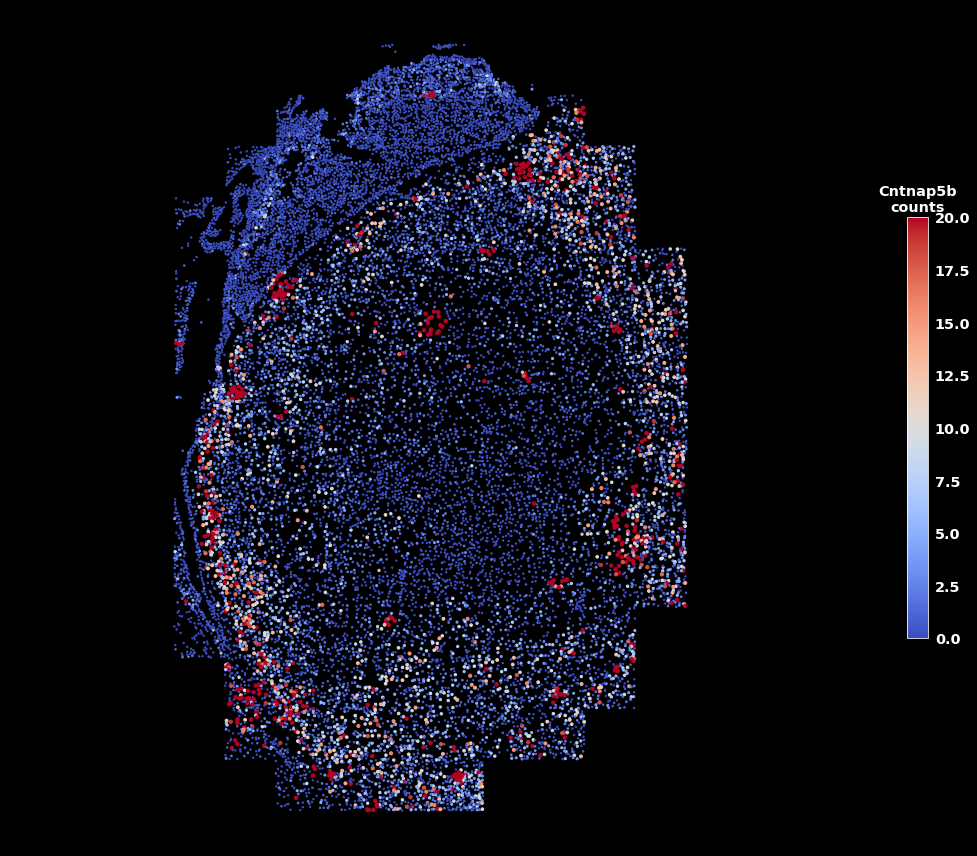

In [364]:
def plot_gene_expression(self,gene,bad_cells=[],vmax=None,vmax_perc=None,name=None,szmin=2,szmax=10):
    dic_count = self.dic_count
    dic_cells_final = self.dic_cells_final
    cells = list(dic_count.keys())
    cells = [cell for cell in cells if ((int(cell)//10**4 not in self.bad_fovs) and (cell not in bad_cells))]
    scores = [dic_count[cell][gene] for cell in cells]
    x,y = -np.array([dic_cells_final[cell]['X'][1:] for cell in cells]).T


    fig = plt.figure(figsize=(15,12), facecolor='black')
    if vmax is None and vmax_perc is None:
        vmax_ = 30
    if vmax_perc is not None:
        vmax_ = np.percentile(scores, vmax_perc)
    if vmax is not None:
        vmax_ = vmax
    sizes = szmin+np.clip(np.array(scores)/vmax_,0,1)*szmax
    plt.scatter(y, x, c=scores, s=sizes, cmap='coolwarm', vmax=vmax_)
    cb = plt.colorbar(shrink=0.5)
    if name is None:
        name = dic_annot.get(gene,gene)
    cb.ax.set_title(f'{name}\ncounts', color='white', fontsize='x-large', fontweight='heavy')
    cb.ax.yaxis.set_tick_params(color='black')
    cb.outline.set_edgecolor('w')
    plt.setp(plt.getp(cb.ax.axes, 'yticklabels'), color='white', fontsize='x-large', fontweight='heavy')
    plt.grid(b=None)
    plt.axis('off')
    plt.axis('equal')
    plt.tight_layout()
    plt.show()
    
plot_gene_expression(rna_,'Q24',vmax=20)

In [365]:
dic_annot = {'Gfap': 'Q1', 'Q1': 'Gfap', 'Cspg4': 'Q2', 'Q2': 'Cspg4', 'Olig1': 'Q3', 'Q3': 'Olig1', 'Cx3cr1': 'Q4', 'Q4': 'Cx3cr1', 'Gja1': 'Q5', 'Q5': 'Gja1', 'Pdgfra': 'Q6', 'Q6': 'Pdgfra', 'Flt1': 'Q7', 'Q7': 'Flt1', 'Gad1': 'Q8', 'Q8': 'Gad1', 'Tmem212': 'Q9', 'Q9': 'Tmem212', 'Aqp4': 'Q10', 'Q10': 'Aqp4', 'Cadps2': 'Q11', 'Q11': 'Cadps2', 'P2ry12': 'Q12', 'Q12': 'P2ry12', 'Rbfox3': 'Q13', 'Q13': 'Rbfox3', 'Dcc': 'Q14', 'Q14': 'Dcc', 'Mog': 'Q15', 'Q15': 'Mog', 'Slc17a7': 'Q16', 'Q16': 'Slc17a7', 'Il1rapl2': 'Q17', 'Q17': 'Il1rapl2', 'Mobp': 'Q18', 'Q18': 'Mobp', 'Col25a1': 'Q19', 'Q19': 'Col25a1', 'Lrrtm4': 'Q20', 'Q20': 'Lrrtm4', 'Fos': 'Q21', 'Q21': 'Fos', 'Dab1': 'Q22', 'Q22': 'Dab1', 'Mgat4c': 'Q23', 'Q23': 'Mgat4c', 'Cntnap5b': 'Q24', 'Q24': 'Cntnap5b', 'Hs3st4': 'Q25', 'Q25': 'Hs3st4', 'Pde10a': 'Q26', 'Q26': 'Pde10a', 'Ldb2': 'Q27', 'Q27': 'Ldb2', 'Hs6st3': 'Q28', 'Q28': 'Hs6st3', 'Sdk1': 'Q29', 'Q29': 'Sdk1', 'Sema6d': 'Q30', 'Q30': 'Sema6d', 'Kirrel3': 'Q31', 'Q31': 'Kirrel3', 'Sgcz': 'Q32', 'Q32': 'Sgcz', 'Tafa2': 'Q33', 'Q33': 'Tafa2', 'Scg2': 'Q34', 'Q34': 'Scg2', 'Bdnf': 'Q35', 'Q35': 'Bdnf', 'Tenm2': 'Q36', 'Q36': 'Tenm2'}
dic_annot.update({"Q103":"Cox6a1","Q104":"Ecel1","Q105":"Cbln2","Q100":"Gria1"})
dic_annot.update({dic_annot[key]:key for key in dic_annot})

In [298]:
print(dic_annot)

{'Gfap': 'Q1', 'Q1': 'Gfap', 'Cspg4': 'Q2', 'Q2': 'Cspg4', 'Olig1': 'Q3', 'Q3': 'Olig1', 'Cx3cr1': 'Q4', 'Q4': 'Cx3cr1', 'Gja1': 'Q5', 'Q5': 'Gja1', 'Pdgfra': 'Q6', 'Q6': 'Pdgfra', 'Flt1': 'Q7', 'Q7': 'Flt1', 'Gad1': 'Q8', 'Q8': 'Gad1', 'Tmem212': 'Q9', 'Q9': 'Tmem212', 'Aqp4': 'Q10', 'Q10': 'Aqp4', 'Cadps2': 'Q11', 'Q11': 'Cadps2', 'P2ry12': 'Q12', 'Q12': 'P2ry12', 'Rbfox3': 'Q13', 'Q13': 'Rbfox3', 'Dcc': 'Q14', 'Q14': 'Dcc', 'Mog': 'Q15', 'Q15': 'Mog', 'Slc17a7': 'Q16', 'Q16': 'Slc17a7', 'Il1rapl2': 'Q17', 'Q17': 'Il1rapl2', 'Mobp': 'Q18', 'Q18': 'Mobp', 'Col25a1': 'Q19', 'Q19': 'Col25a1', 'Lrrtm4': 'Q20', 'Q20': 'Lrrtm4', 'Fos': 'Q21', 'Q21': 'Fos', 'Dab1': 'Q22', 'Q22': 'Dab1', 'Mgat4c': 'Q23', 'Q23': 'Mgat4c', 'Cntnap5b': 'Q24', 'Q24': 'Cntnap5b', 'Hs3st4': 'Q25', 'Q25': 'Hs3st4', 'Pde10a': 'Q26', 'Q26': 'Pde10a', 'Ldb2': 'Q27', 'Q27': 'Ldb2', 'Hs6st3': 'Q28', 'Q28': 'Hs6st3', 'Sdk1': 'Q29', 'Q29': 'Sdk1', 'Sema6d': 'Q30', 'Q30': 'Sema6d', 'Kirrel3': 'Q31', 'Q31': 'Kirrel3', 'Sgcz

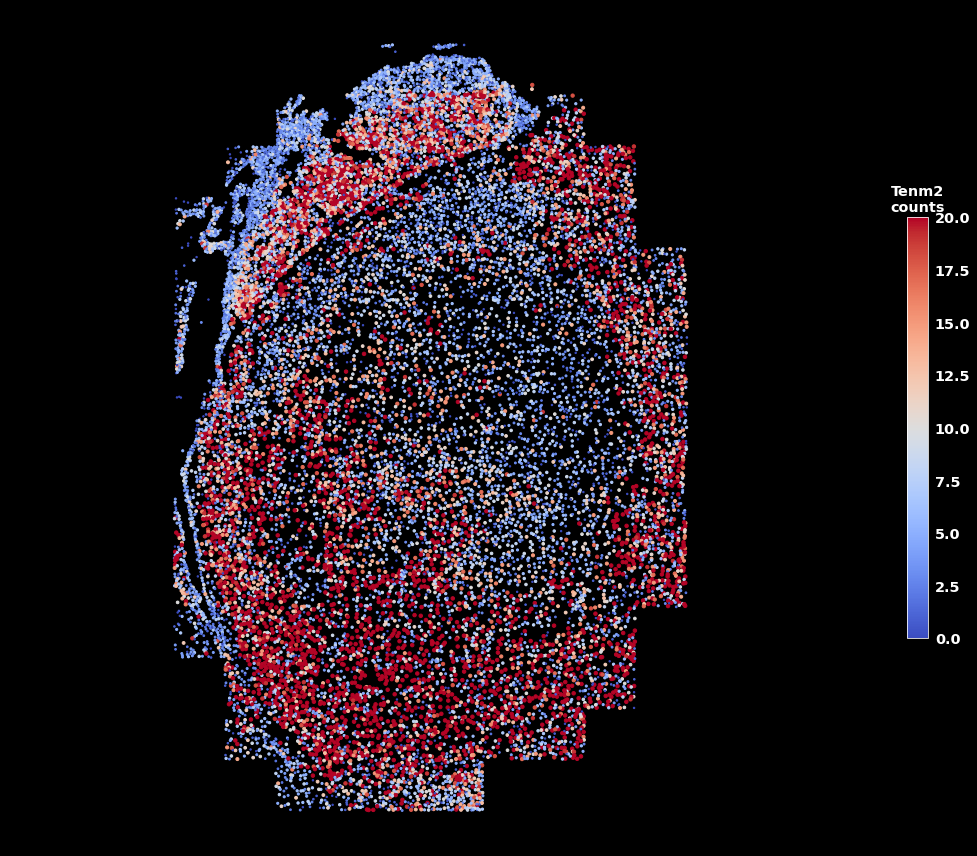

In [375]:
Q = dic_annot['Tenm2']
save_fl = rna_.save_fld+os.sep+Q+'_bad_cells.npy'
bad_cells = []
if os.path.exists(save_fl):
    bad_cells = np.load(save_fl)
plot_gene_expression(rna_,Q,bad_cells=bad_cells,vmax=20,szmin=2,szmax=10)

In [376]:

from sklearn.cluster import DBSCAN    
def find_cells_next_to_artifacts(self,Q,save=True,plt_val=True,th_h=0.5,resc=10,eps=17.5,min_samples=125):
    """
    requires the <rna_> object and the fit files <fls_all>
    
    """
    save_fld = os.path.dirname(self.fls[0])
    fls_all = getattr(self,'fls_fits_all',None)
    if fls_all is None:
        fls_all = glob.glob(save_fld+os.sep+'*--*--dic_pts_cell_Xh_RNAs.pkl')
        self.fls_fits_all = fls_all
    fls = [fl for fl in fls_all if Q in fl_to_gnQtag(fl)]
    icol = list(fl_to_gnQtag(fls[0])).index(Q)

    ### # get the positions of each fov 
    Xfovs = self.pos_fovs
    
    ### Load all the fitted points
    Xf=[]
    for fl in tqdm(fls[:]):
        fov = get_fov(fl)
        Xs = pickle.load(open(fl,'rb'))
        X1 = Xs[icol]
        if len(X1):
            Xfv = Xfovs[fov]
            h = X1[:,-1]
            keep = h>th_h
            Xf.extend(X1[keep,1:3]*[0.10833,0.10833]+[Xfv[0],Xfv[1]])
    Xf = np.array(Xf)

    Xf_ = Xf[::resc]

    dbscan = DBSCAN(eps=eps,min_samples = min_samples)
    dbscan.fit(Xf_)
    labels_ = dbscan.labels_
    ulab,cts_lab = np.unique(labels_,return_counts=True)
    from sklearn.neighbors import NearestNeighbors
    from scipy.spatial import cKDTree as KDTree
    tree = KDTree(Xf_[labels_>-1])
    
    
    dic_cells_final,dic_count = self.dic_cells_final,self.dic_count
    
    
    cells = list(dic_cells_final.keys())
    Xcells = np.array([dic_cells_final[cell]['X'][1:] for cell in cells])
    binds = np.array([len(e)>0 for ie,e in enumerate(tree.query_ball_point(Xcells,20))])
    has_counts = np.array([dic_count[cell][Q] for cell in cells])>5
    bad_cells = np.array(cells)[binds&has_counts]
    bad_cells_all =  np.array(cells)[binds]
    if save:
        save_fl = save_fld+os.sep+Q+'_bad_cells.npy'
        np.save(save_fl,bad_cells)
        save_fl = save_fld+os.sep+Q+'bad_cells_all.npy'
        np.save(save_fl,bad_cells_all)
        
    if plt_val:
        genes = ['Q'+str(i+1) for i in range(48)]
        genes_names=['Adarb2', 'Apod', 'Atp1a2', 'C1ql3', 'Cacnb2', 'Cald1', 'Camk2d', 'Camk2n1', 'Cdh18', 'Cnr1', 'Cst3', 'Cttnbp2', 'Dab1', 'Dcc', 'Dcn', 'Flt1', 'Fras1', 'Gad2', 'Hs3st2', 'Hs3st4', 'Il1rapl2', 'Kcnc2', 'Kcnq5', 'Mef2c', 'Meis2', 'Mt1', 'Ndnf', 'Ndst4', 'Nnat', 'Nos1', 'Nr4a2', 'Nrep', 'Ntng1', 'Ppfia2', 'Ptprd', 'Qk', 'Rbms3', 'Sgcd', 'Slc6a1', 'Sst', 'Tafa1', 'Tafa2', 'Trps1', 'Tshz2', 'Wfs1', 'Wipf3', 'Zbtb20', 'Zfpm2']
        dic_Q_to_gene = {gn:gn_nm for gn,gn_nm in zip(genes,genes_names)}
        dic_gene_to_Q = {gn_nm:gn for gn,gn_nm in zip(genes,genes_names)}
        #for gene in [dic_Q_to_gene[Q]]:#['Sst']:#genes_names:dic_Q_to_gene['Q3']
        #gene = dic_Q_to_gene[Q]
        #gene = dic_Q_to_gene['Q34']
            #rna_.plot_gene_expression(dic_gene_to_Q[gene],vmax=None,vmax_perc=None,name=gene)

        plot_gene_expression(self,Q,bad_cells=[],vmax=None,vmax_perc=None,name=None)
        #print(dic_gene_to_Q[gene])
        plt.show()
        plot_gene_expression(self,Q,bad_cells=bad_cells,vmax=None,vmax_perc=None,name=None)
        #print(dic_gene_to_Q[gene])
        plt.show()
        
        
def complete_nan_dic_count(dic_count):
    #print("Correcting the cells in those fovs...")
    cells = list(dic_count.keys())
    cell = cells[0]
    qs = list(dic_count[cell].keys())
    X = np.array([[dic_count[cell][q] for q in qs]for cell in cells])
    bad_ = np.any(np.isnan(X),axis=1)
    cells_bad = np.where(bad_)[0]
    cells_good = np.where(~bad_)[0]

    X_ = X#/np.nansum(X,axis=-1)[:,np.newaxis]
    X_bad_ = X_[cells_bad]
    X_good_ = X_[cells_good]
    best_cells = [np.argsort(np.nanmean(np.abs(X__-X_good_),axis=-1))[:10] for X__ in tqdm(X_bad_[:])]

    X_copy = X.copy()
    for ibad in range(len(best_cells)):   
        ibest = best_cells[ibad]
        where_bad = np.isnan(X_bad_[ibad])
        new_vals = np.nanmedian(X[cells_good][ibest][:,where_bad],axis=0)
        X_copy[cells_bad[ibad],where_bad] = new_vals
        #new_vals = np.nanmedian(X[cells_good][ibest][:,:],axis=0)
        #X_copy[cells_bad[ibad],:] = X[cells_good][ibest[0]]#new_vals
    #dic_count = self.dic_count
    for icell,cell in enumerate(cells):
        for iq,q in enumerate(qs):
            dic_count[cell][q] = X_copy[icell,iq]
    return dic_count
def complete_nan_dic_count(dic_count):
    #print("Correcting the cells in those fovs...")
    #dic_count = dic_ct_cor
    cells = list(dic_count.keys())
    cell = cells[0]
    dicT = dic_count[cell]
    if type(dicT) is dict:
        qs = list(dic_count[cell].keys())
    else:
        qs = np.arange(len(dic_count[cell]))#
    X = np.array([[dic_count[cell][q] for q in qs]for cell in cells])
    bad_ = np.any(np.isnan(X),axis=1)
    cells_bad = np.where(bad_)[0]
    cells_good = np.where(~bad_)[0]

    X_ = X#/np.nansum(X,axis=-1)[:,np.newaxis]
    X_bad_ = X_[cells_bad]
    X_good_ = X_[cells_good]

    from scipy.stats import zscore
    X_good_z = zscore(X_good_,axis=0)
    X_bad_z = (X_bad_-np.nanmean(X_bad_,axis=0))/np.nanstd(X_bad_,axis=0)
    X_bad_z[np.isnan(X_bad_z)]=0

    from scipy.spatial import cKDTree as kdtree
    tree = kdtree(X_good_z)
    dist,best_cells = tree.query(X_bad_z,10,workers=30);
    X_copy = X.copy()
    Xgood_close = np.nanmedian(X[cells_good][best_cells],axis=1)
    bad_inds = np.isnan(X_bad_)

    Xgood_close_ = Xgood_close.copy()
    Xgood_close_[bad_inds]=np.nan
    nsums_close = np.nansum(Xgood_close_,axis=-1)[:,np.newaxis]
    nsums_bad = np.nansum(X_bad_,axis=-1)[:,np.newaxis]
    Xgood_close_ = Xgood_close/nsums_close*nsums_bad
    Xgood_close_[np.isnan(Xgood_close_)]=0
    Xgood_close_[np.isinf(Xgood_close_)]=0
    X_copy[np.isnan(X_copy)]=Xgood_close_[bad_inds]

    for icell,cell in tqdm(enumerate(cells)):
        for iq,q in enumerate(qs):
            dic_count[cell][q] = X_copy[icell,iq]
    return dic_count

In [377]:
#dic_annot = {'Gfap': 'Q1', 'Q1': 'Gfap', 'Cspg4': 'Q2', 'Q2': 'Cspg4', 'Olig1': 'Q3', 'Q3': 'Olig1', 'Cx3cr1': 'Q4', 'Q4': 'Cx3cr1', 'Gja1': 'Q5', 'Q5': 'Gja1', 'Pdgfra': 'Q6', 'Q6': 'Pdgfra', 'Flt1': 'Q7', 'Q7': 'Flt1', 'Gad1': 'Q8', 'Q8': 'Gad1', 'Tmem212': 'Q9', 'Q9': 'Tmem212', 'Aqp4': 'Q10', 'Q10': 'Aqp4', 'Cadps2': 'Q11', 'Q11': 'Cadps2', 'P2ry12': 'Q12', 'Q12': 'P2ry12', 'Rbfox3': 'Q13', 'Q13': 'Rbfox3', 'Dcc': 'Q14', 'Q14': 'Dcc', 'Mog': 'Q15', 'Q15': 'Mog', 'Slc17a7': 'Q16', 'Q16': 'Slc17a7', 'Il1rapl2': 'Q17', 'Q17': 'Il1rapl2', 'Mobp': 'Q18', 'Q18': 'Mobp', 'Col25a1': 'Q19', 'Q19': 'Col25a1', 'Lrrtm4': 'Q20', 'Q20': 'Lrrtm4', 'Fos': 'Q21', 'Q21': 'Fos', 'Dab1': 'Q22', 'Q22': 'Dab1', 'Mgat4c': 'Q23', 'Q23': 'Mgat4c', 'Cntnap5b': 'Q24', 'Q24': 'Cntnap5b', 'Hs3st4': 'Q25', 'Q25': 'Hs3st4', 'Pde10a': 'Q26', 'Q26': 'Pde10a', 'Ldb2': 'Q27', 'Q27': 'Ldb2', 'Hs6st3': 'Q28', 'Q28': 'Hs6st3', 'Sdk1': 'Q29', 'Q29': 'Sdk1', 'Sema6d': 'Q30', 'Q30': 'Sema6d', 'Kirrel3': 'Q31', 'Q31': 'Kirrel3', 'Sgcz': 'Q32', 'Q32': 'Sgcz', 'Tafa2': 'Q33', 'Q33': 'Tafa2', 'Scg2': 'Q34', 'Q34': 'Scg2', 'Bdnf': 'Q35', 'Q35': 'Bdnf', 'Tenm2': 'Q36', 'Q36': 'Tenm2'}
#dic_annot.update({"Q103":"Cox6a1","Q104":"Ecel1","Q105":"Cbln2","Q100":"Gria1"})
#dic_annot.update({dic_annot[key]:key for key in dic_annot})

In [213]:
bad_genes = ['2310069B03Rik', '4833407H14Rik', '4930570B17Rik', '6330549D23Rik', '9630013A20Rik', 'A230056P14Rik', 'A330040F15Rik', 'A830009L08Rik', 'Ache', 'Adgrl3', 'Anxa2', 'Arpp21', 'B630019A10Rik', 'BC030343', 'Batf3', 'Bcl6', 'Bgn', 'Cacnb2', 'Camk2b', 'Ccl2', 'Cd81', 'Cdc25c', 'Cdca8', 'Cdh13', 'Cdk2', 'Cenpa', 'Chaf1b', 'Clcf1', 'Clec12a', 'Cnp', 'Cpne6', 'Crb1-ps', 'Crip1', 'Crym', 'Csdc2', 'Cxcl10', 'Cxcl11', 'D030046N08Rik', 'Dbi', 'Dbpht2', 'Dcn', 'Ddx5', 'Dio3os', 'Dlgap5', 'Dlx6os1', 'Doc2g', 'Dscc1', 'Dtl', 'Egfem1', 'Eif2s3y', 'Esco2', 'Evx1os', 'Fabp5', 'Fam20c', 'Fam227b', 'Fst', 'Fth1', 'Fxyd6', 'Gad1', 'Gch1', 'Gimap1', 'Gja1', 'Gm10076', 'Gm10222', 'Gm10575', 'Gm12218', 'Gm13205', 'Gm15215', 'Gm15500', 'Gm17750', 'Gm17767', 'Gm20605', 'Gm2316', 'Gm2694', 'Gm28050', 'Gm28268', 'Gm32647', 'Gm34304', 'Gm3764', 'Gm42397', 'Gm43055', 'Gm4887', 'Gm49164', 'Gm5083', 'Gm6277', 'Gm7565', 'Gm9006', 'Gm9169', 'Gm9531', 'Gpx2', 'Gramd3', 'Grb14', 'H19', 'Hdac8', 'Hmgn2', 'Hoxb5', 'Ighm', 'Inpp5j', 'Irf7', 'Kcnab1', 'Kcnip2', 'Kl', 'Lcn2', 'Lef1', 'Lhx1os', 'Lockd', 'Lsp1', 'Ly86', 'Malat1', 'Matn4', 'Mcm2', 'Meg3', 'Meis2', 'Mfge8', 'Mgp', 'Mia', 'Miat', 'Mif', 'Mis18bp1', 'Ms4a6b', 'Ms4a7', 'Mtrf1', 'Mxd3', 'Myl4', 'Nasp', 'Ndc80', 'Nme5', 'Npas1', 'Npff', 'Nrp1', 'Ntsr2', 'Nuf2', 'Nupr1', 'Odf3b', 'Opalin', 'Pantr1', 'Pclaf', 'Pde6g', 'Pde7b', 'Pdhb', 'Pdlim1', 'Pdlim4', 'Pglyrp1', 'Prc1', 'Prim1', 'Psrc1', 'Ptbp2', 'Ptgds', 'Reg3g', 'Rexo2', 'Rgs14', 'Rln1', 'Rnasel', 'Rnd2', 'Rpl23a-ps3', 'Rpl7a', 'Rps19', 'Rras2', 'Rrm1', 'Rwdd3', 'Sag', 'Sap30bpos', 'Selplg', 'Septin7', 'Serpine2', 'Sgcd', 'Slbp', 'Slc12a7', 'Slc17a7', 'Slc18a2', 'Slc1a3', 'Slc44a3', 'Smim3', 'Smim43', 'Snap25', 'Snca', 'Snhg18', 'Spsb4', 'Stmn2', 'Sync', 'Synpr', 'Syp', 'Tac1', 'Tgfb1', 'Thrsp', 'Tmed7', 'Tmem108', 'Tmem141', 'Tmem176a', 'Trem2', 'Trim9', 'Tsix', 'Ttc16', 'Ung', 'Vim', 'Vip', 'Xist']
[gn for gn in dic_annot if gn in bad_genes]

['Gja1', 'Gad1', 'Slc17a7']

In [379]:
dic_count = rna_.dic_count
all_keys = np.unique([list(dic_count[cell].keys()) for cell in dic_count.keys()])
len(all_keys)

42

In [275]:
??find_cells_next_to_artifacts

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

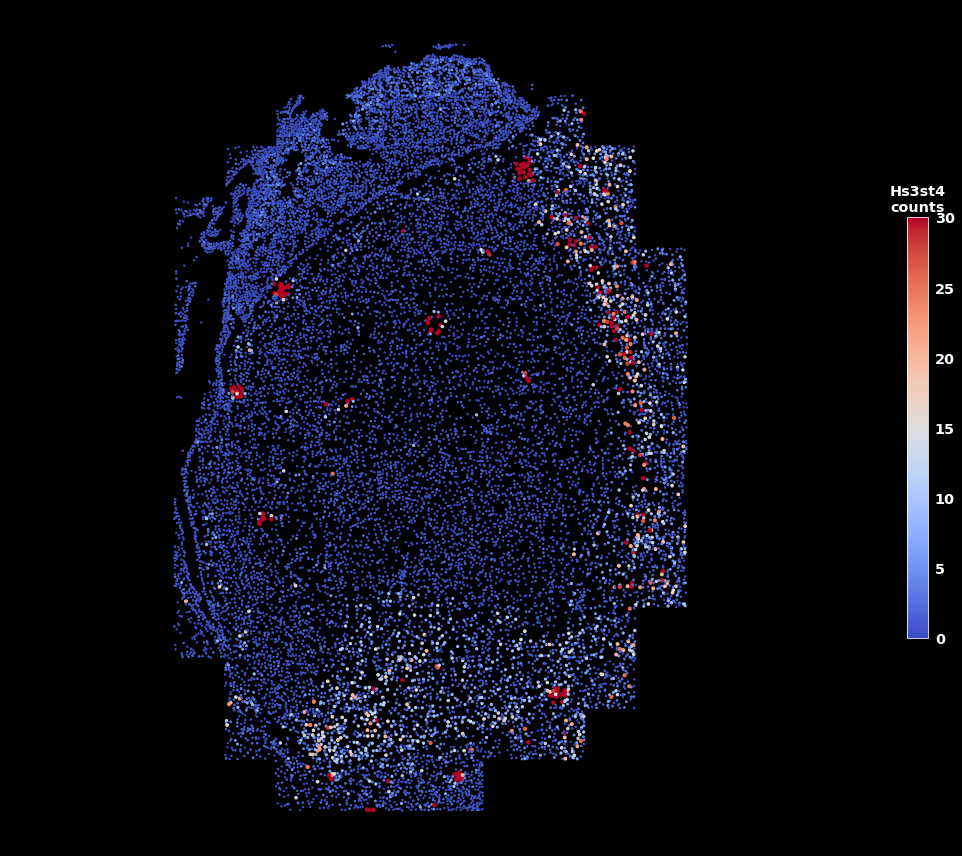

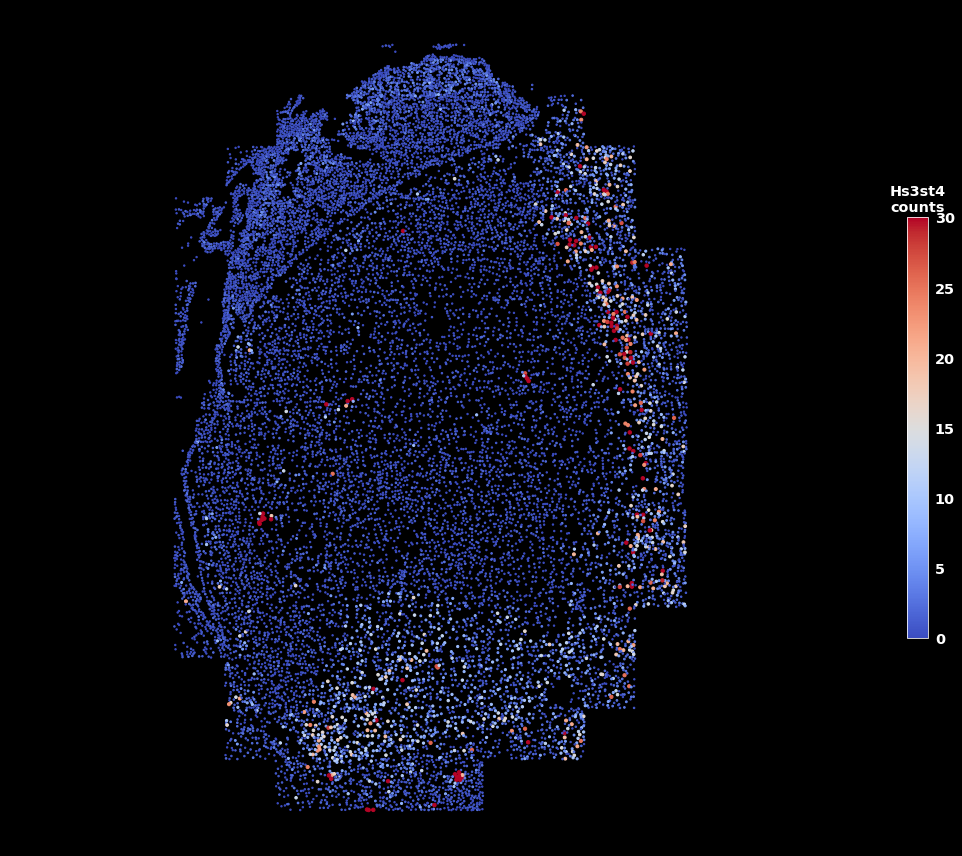

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

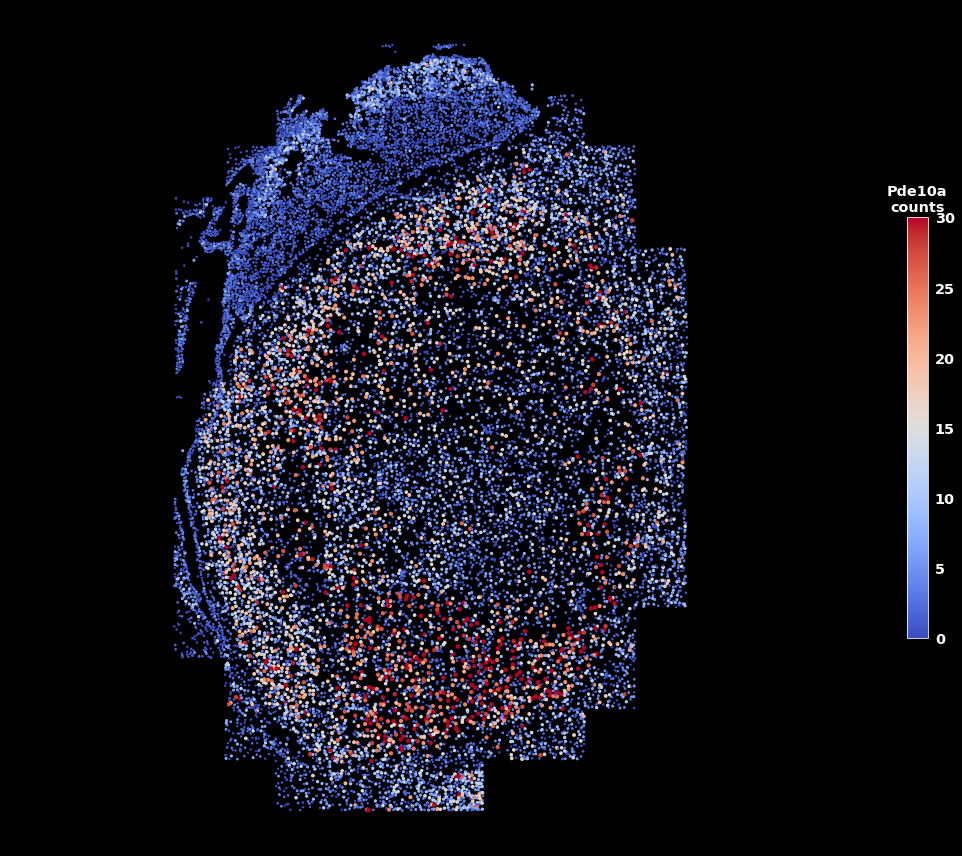

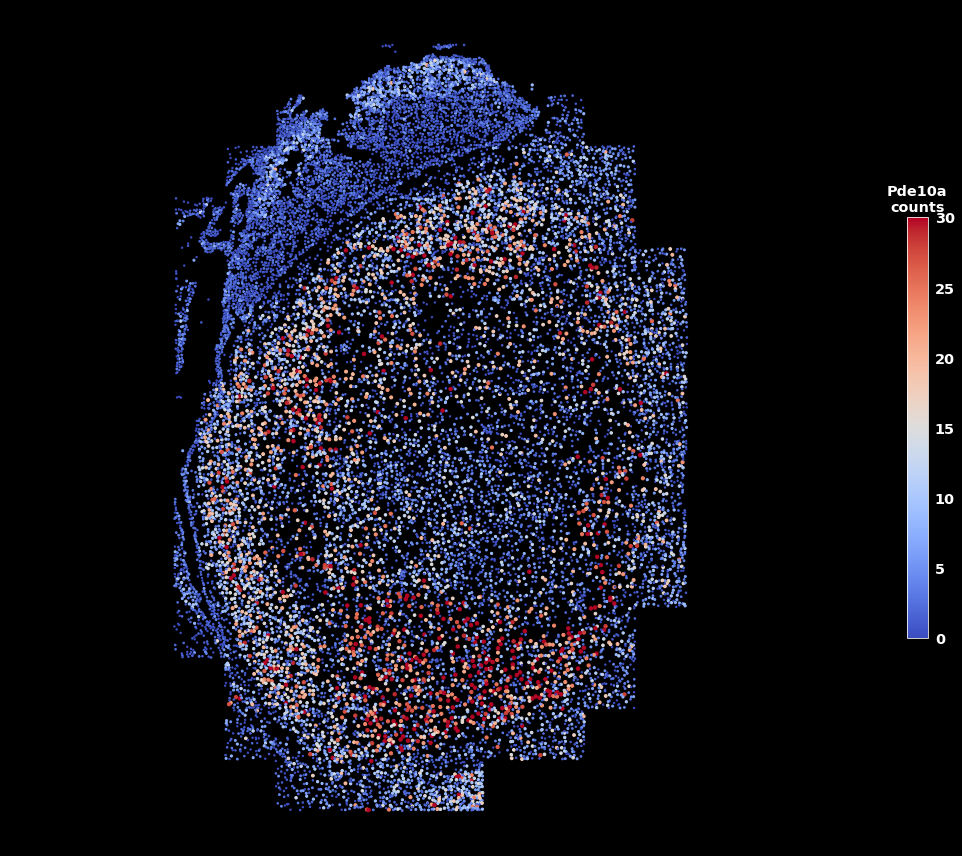

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

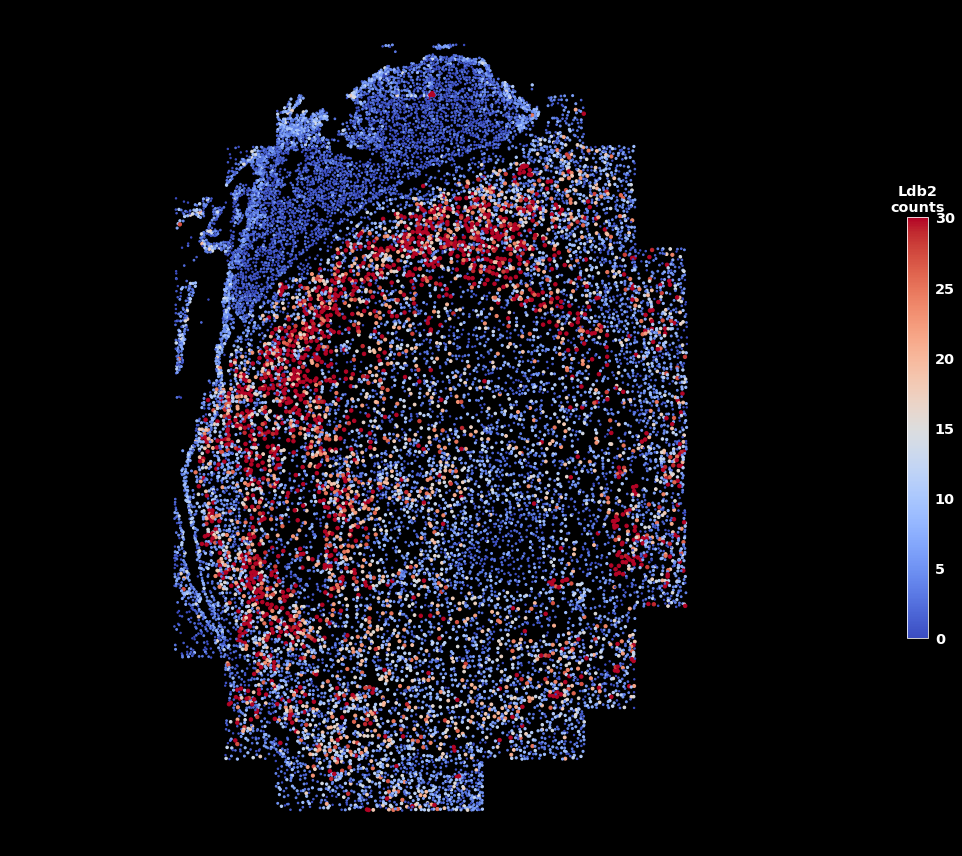

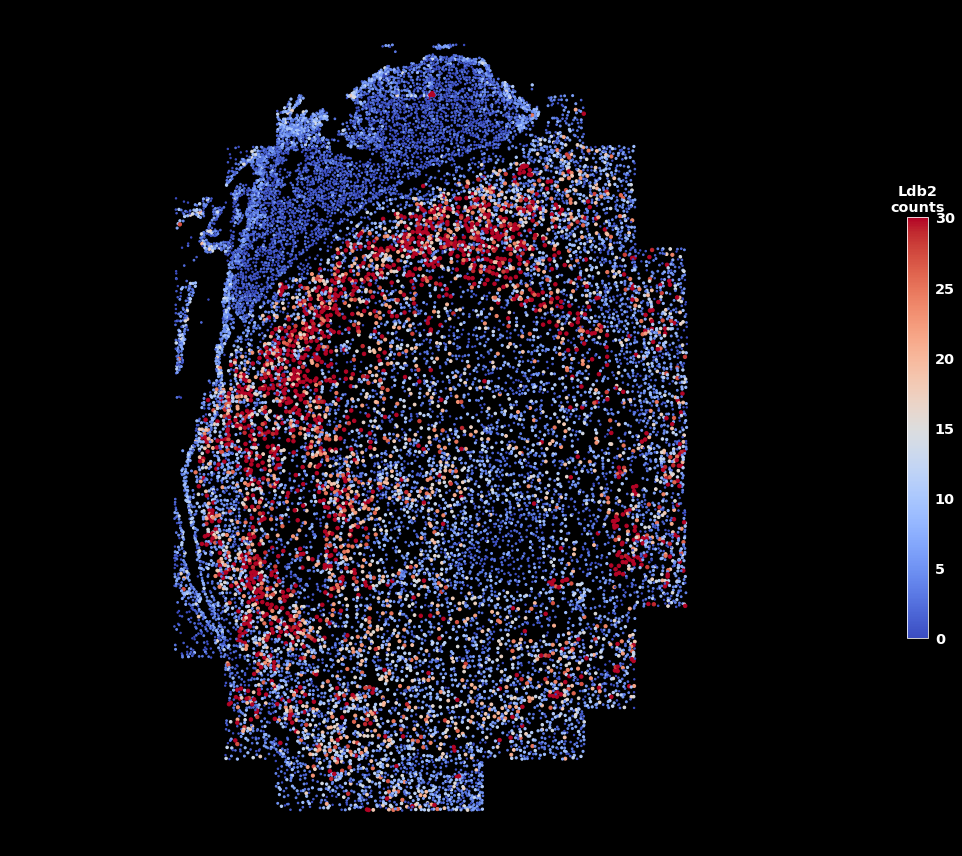

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

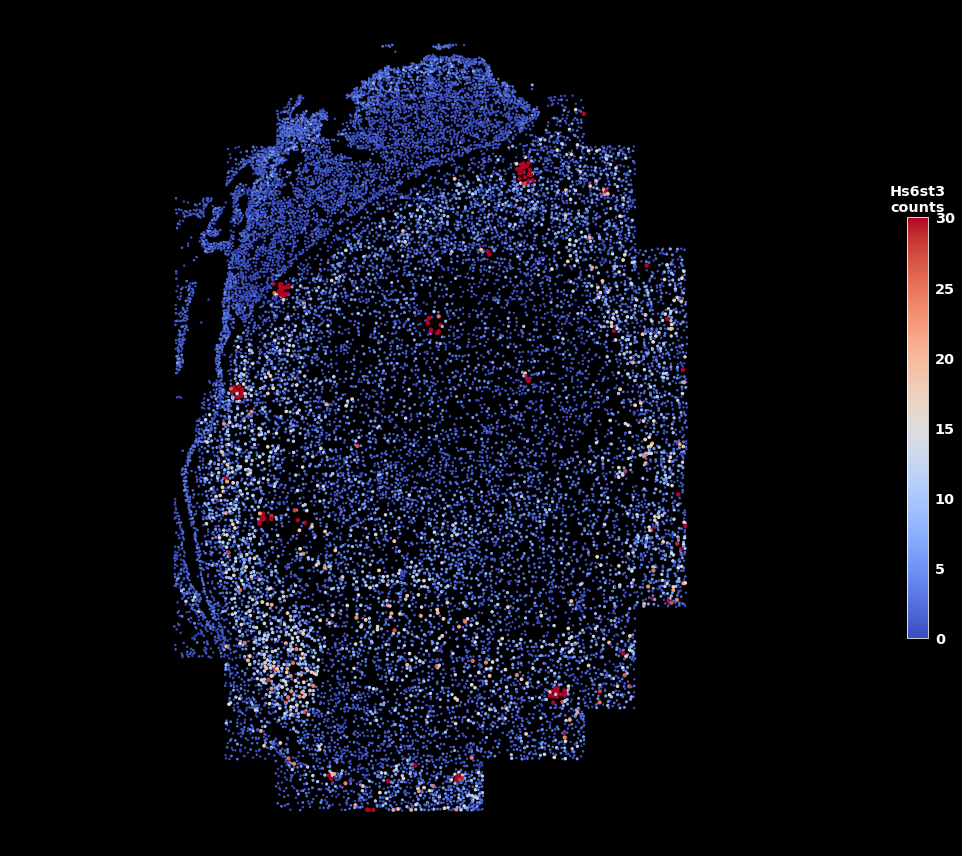

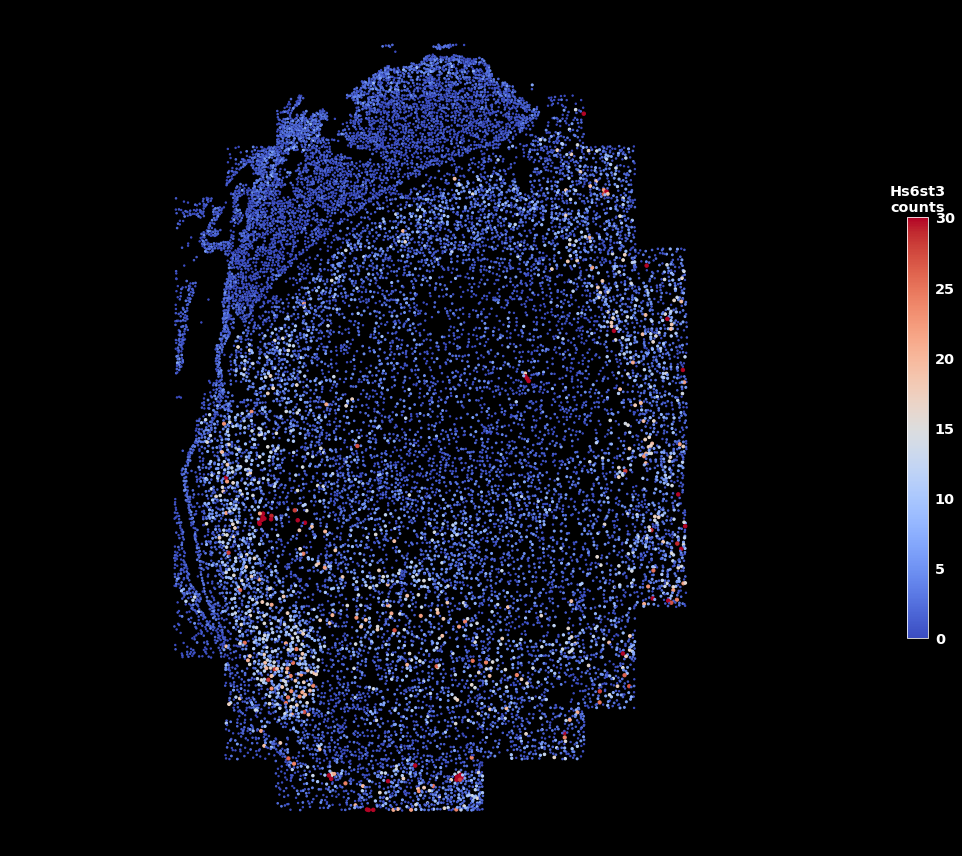

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

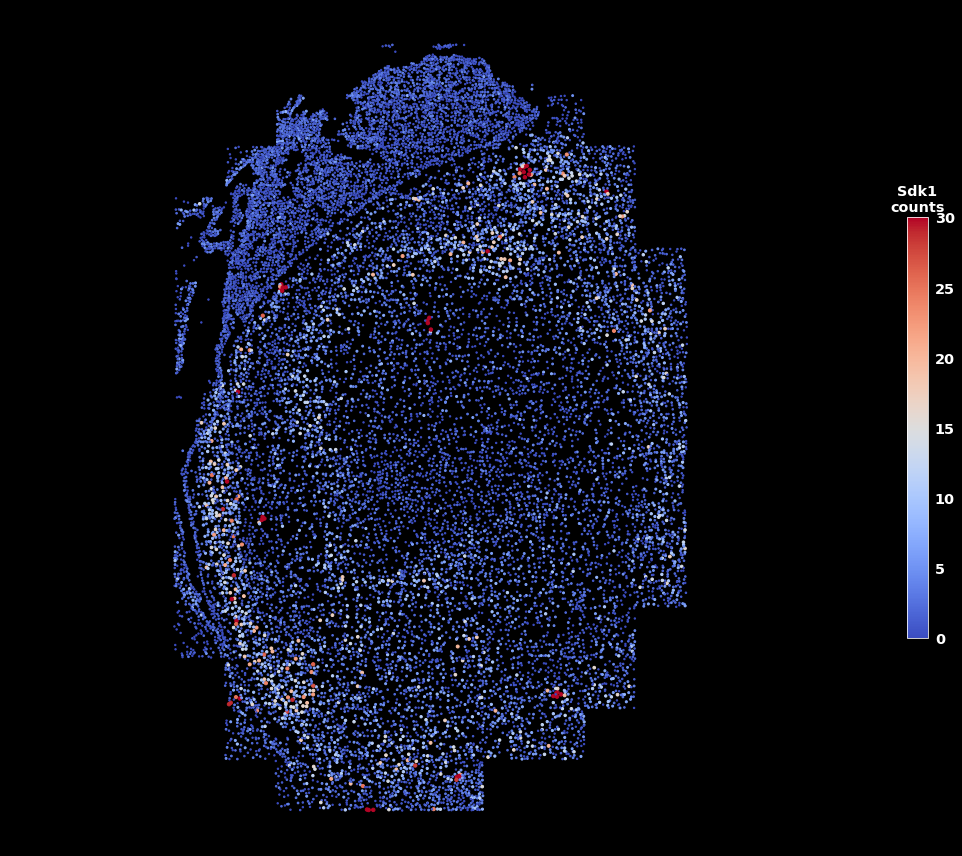

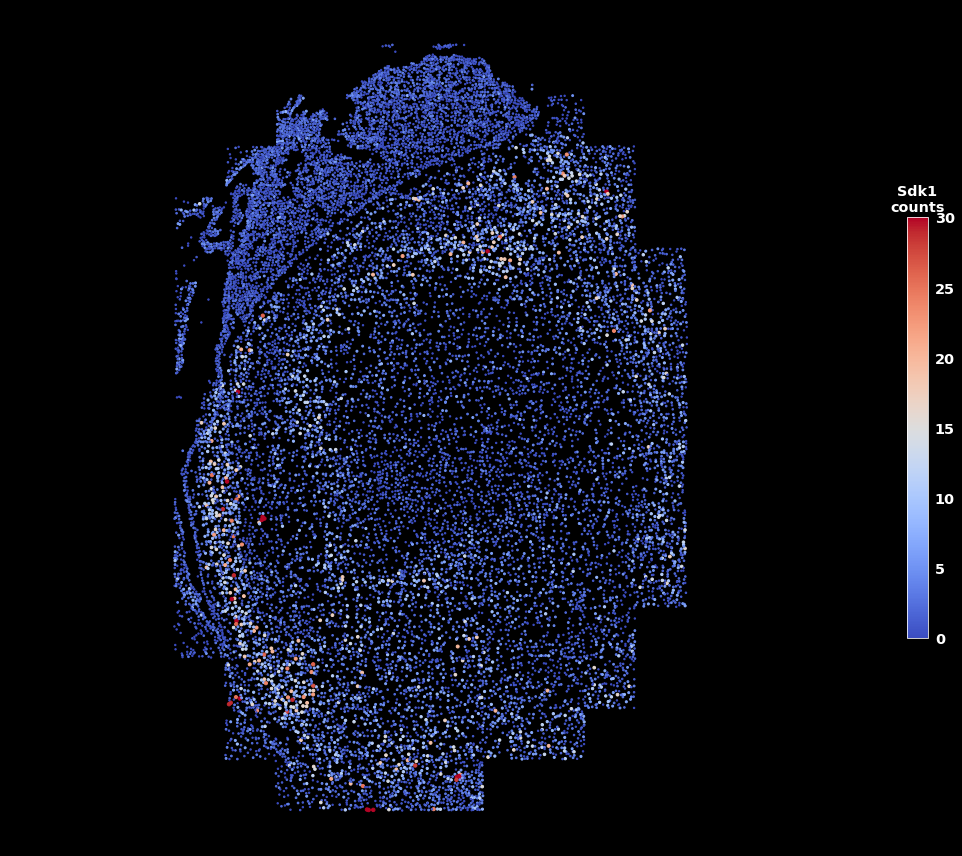

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

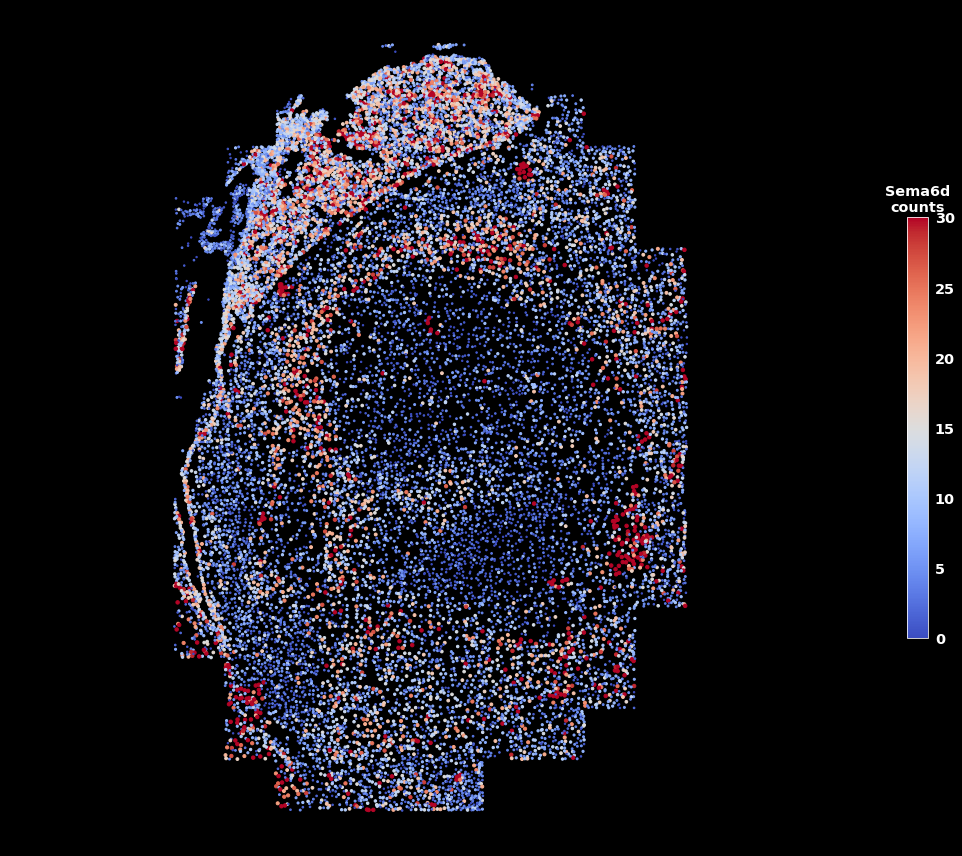

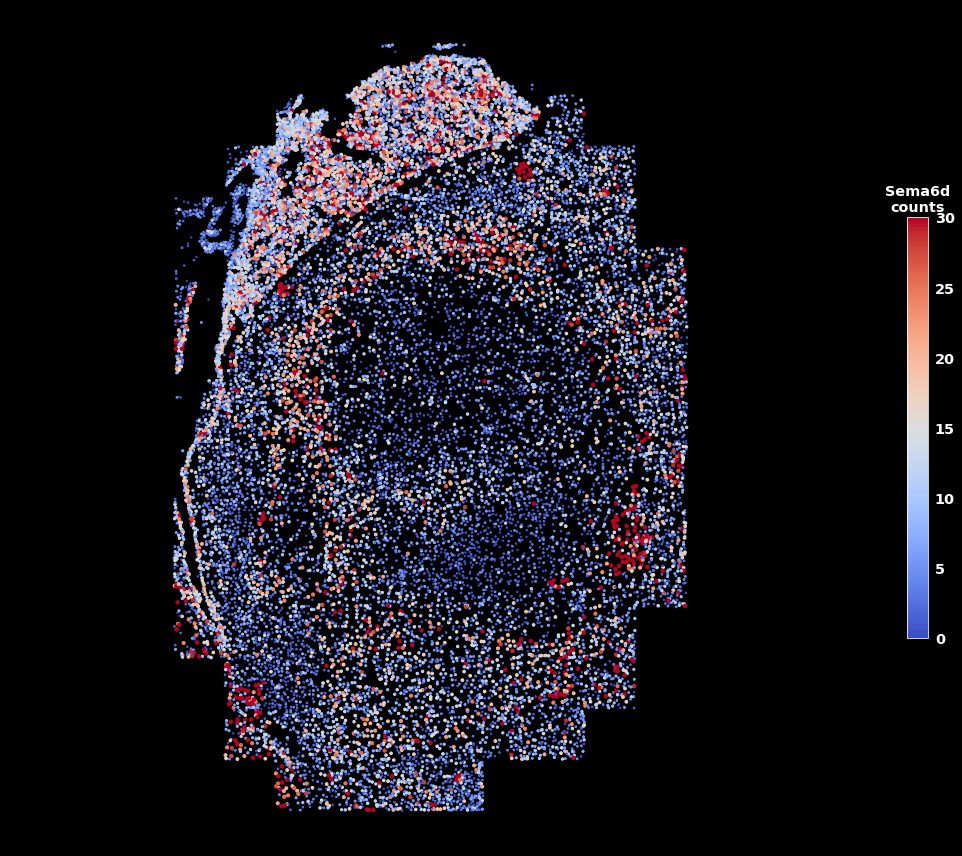

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

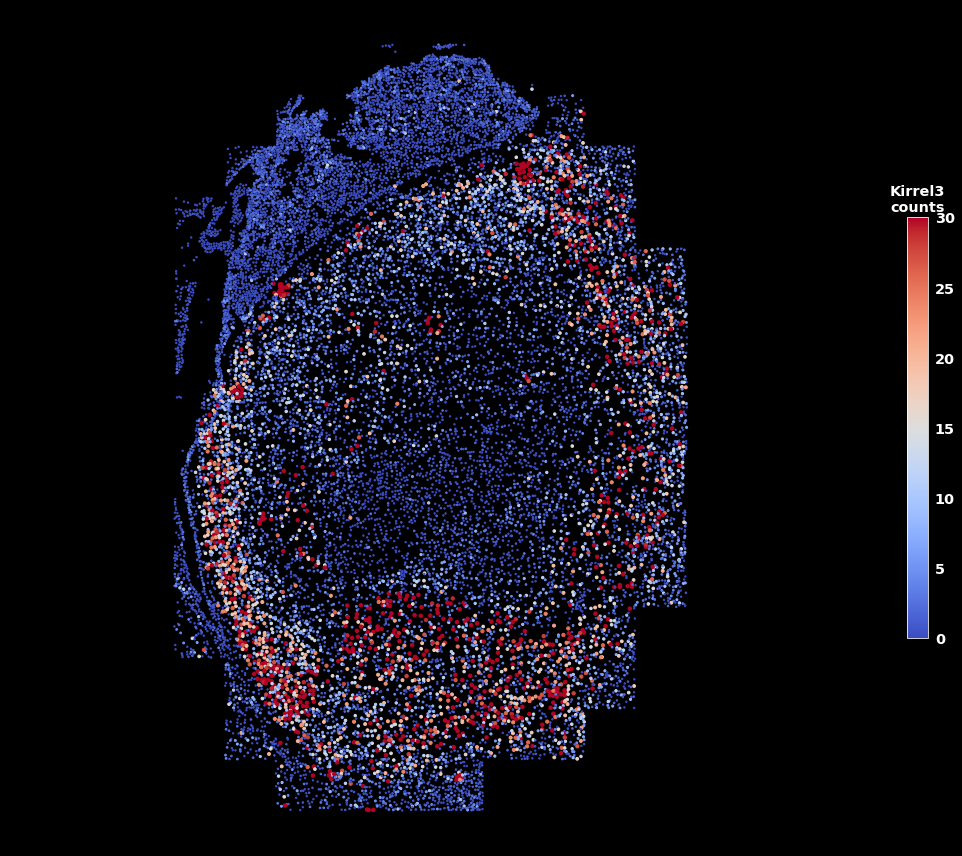

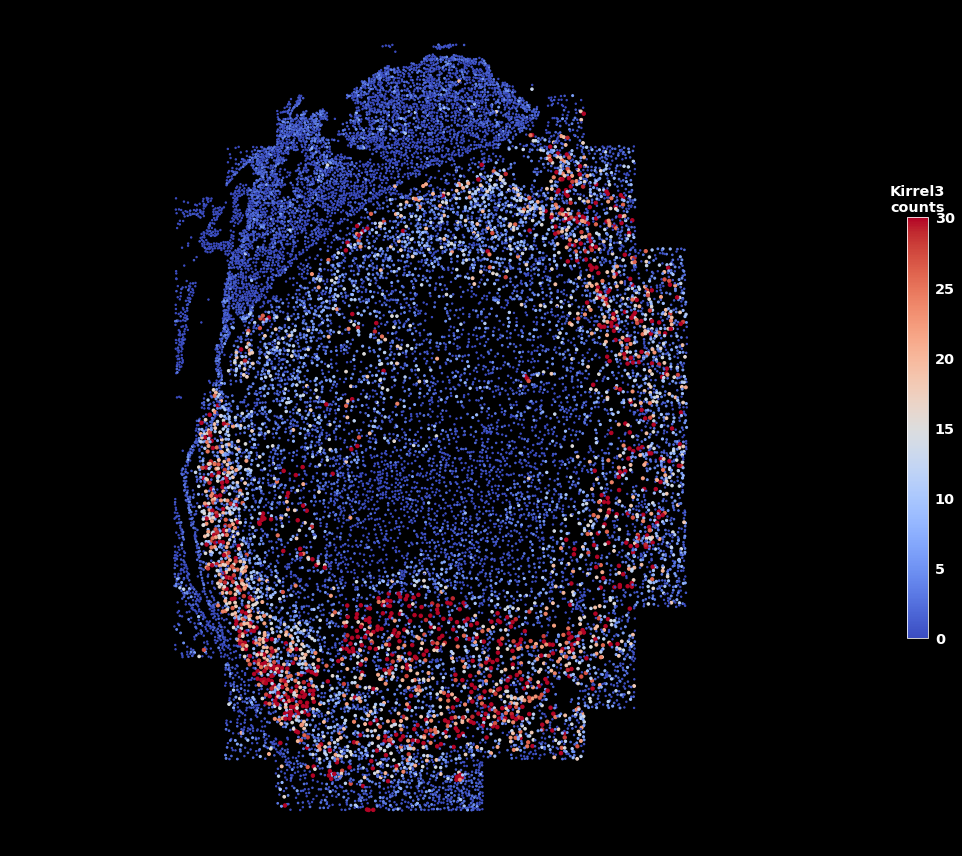

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

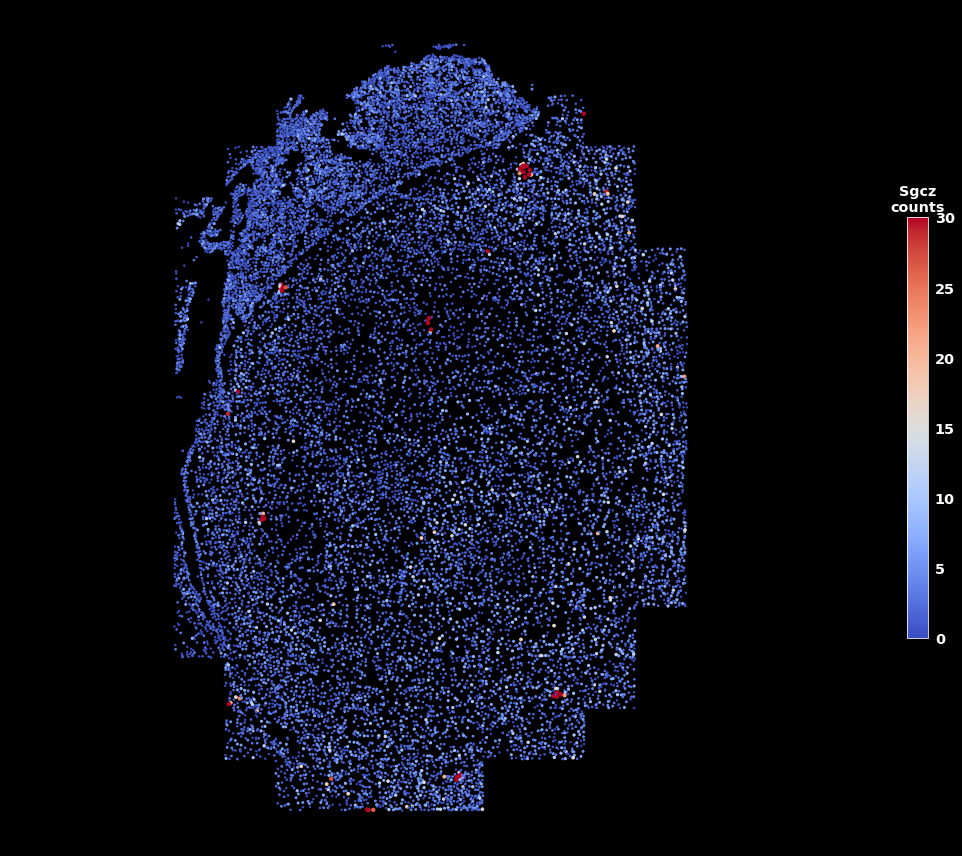

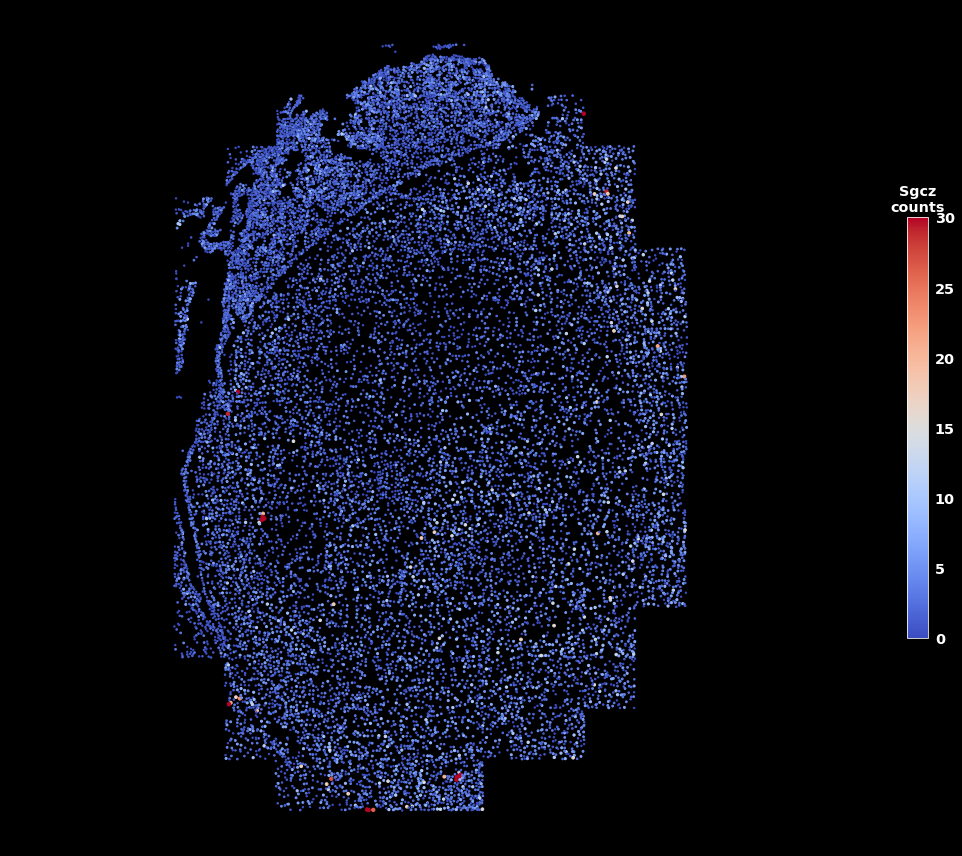

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

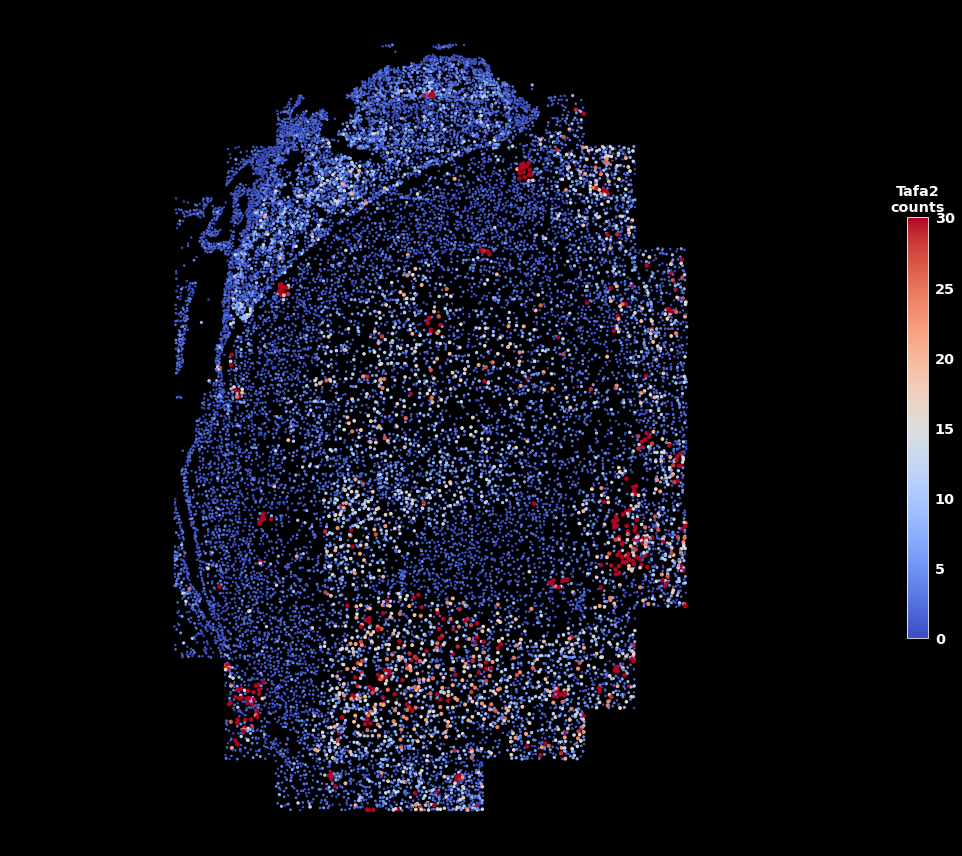

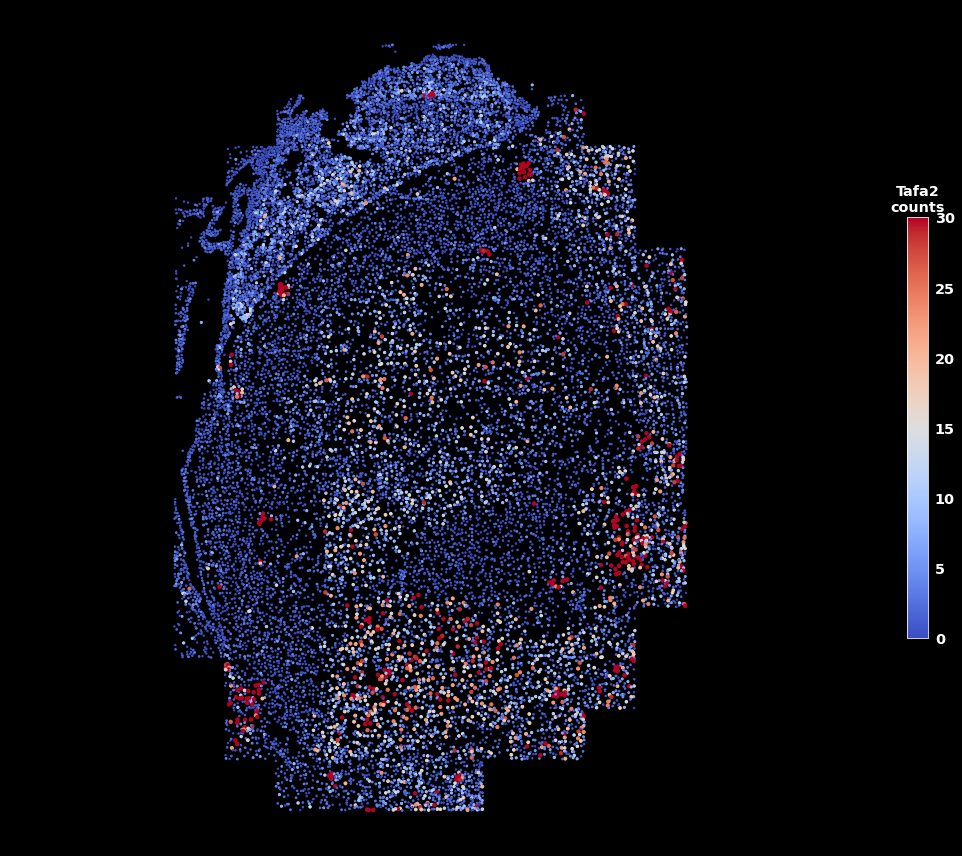

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

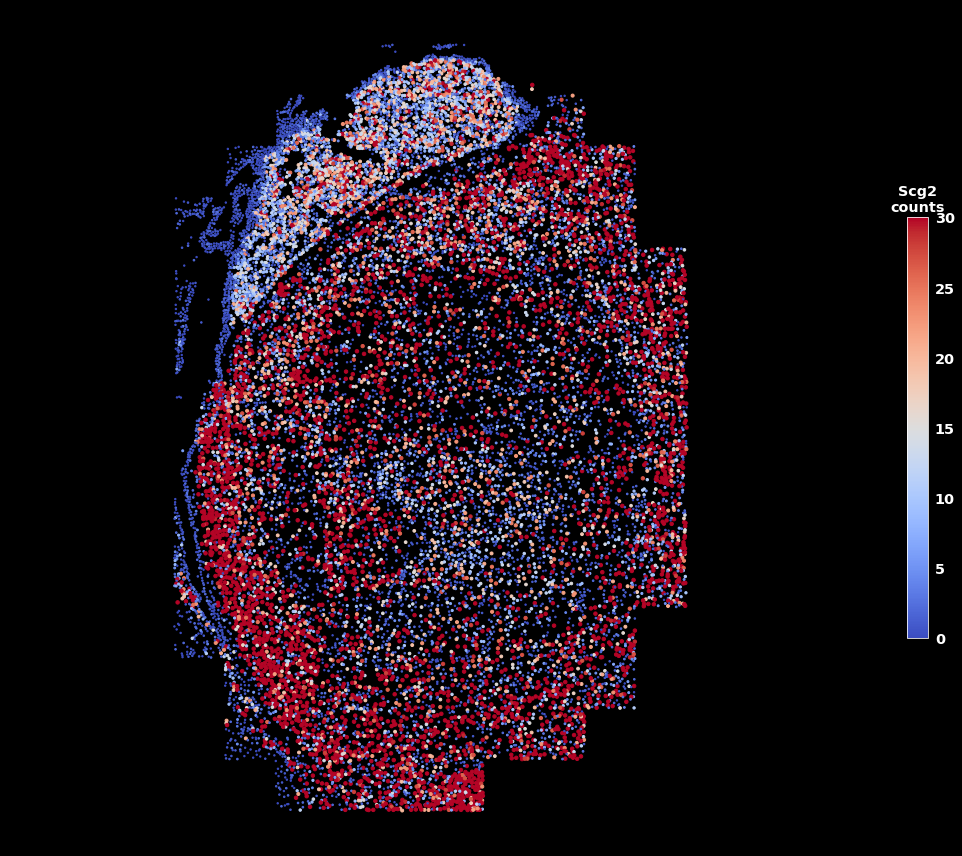

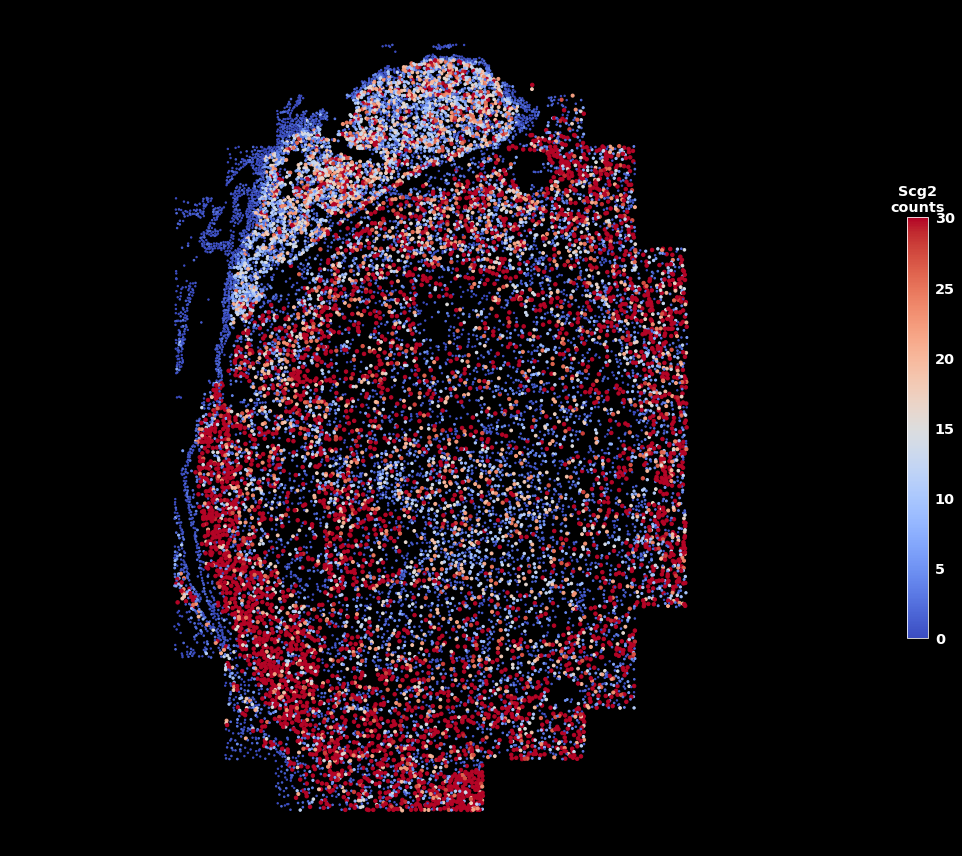

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

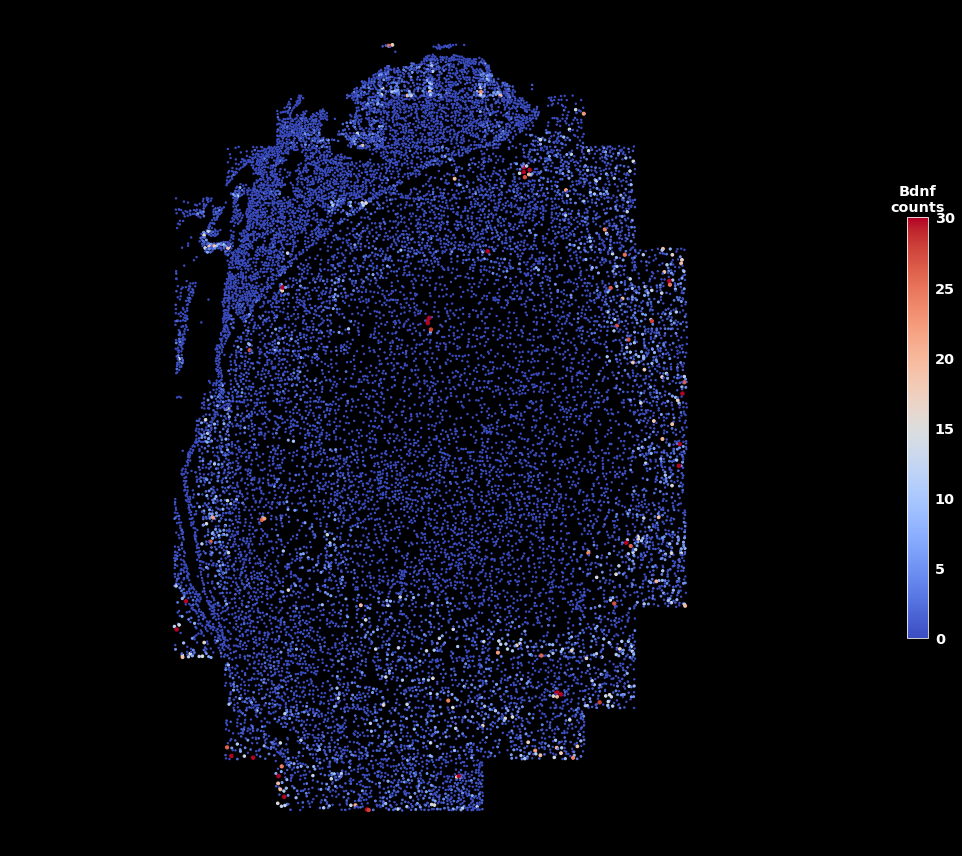

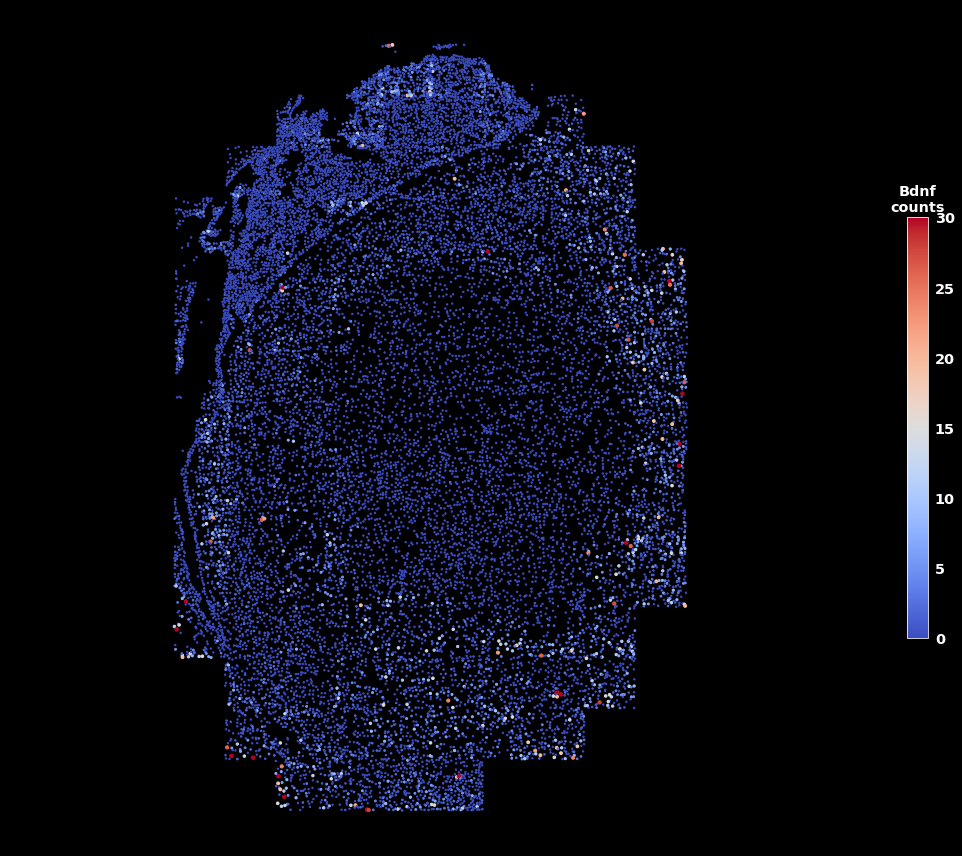

<ipython-input-376-87497710bbe6>:20: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for fl in tqdm(fls[:]):


  0%|          | 0/125 [00:00<?, ?it/s]

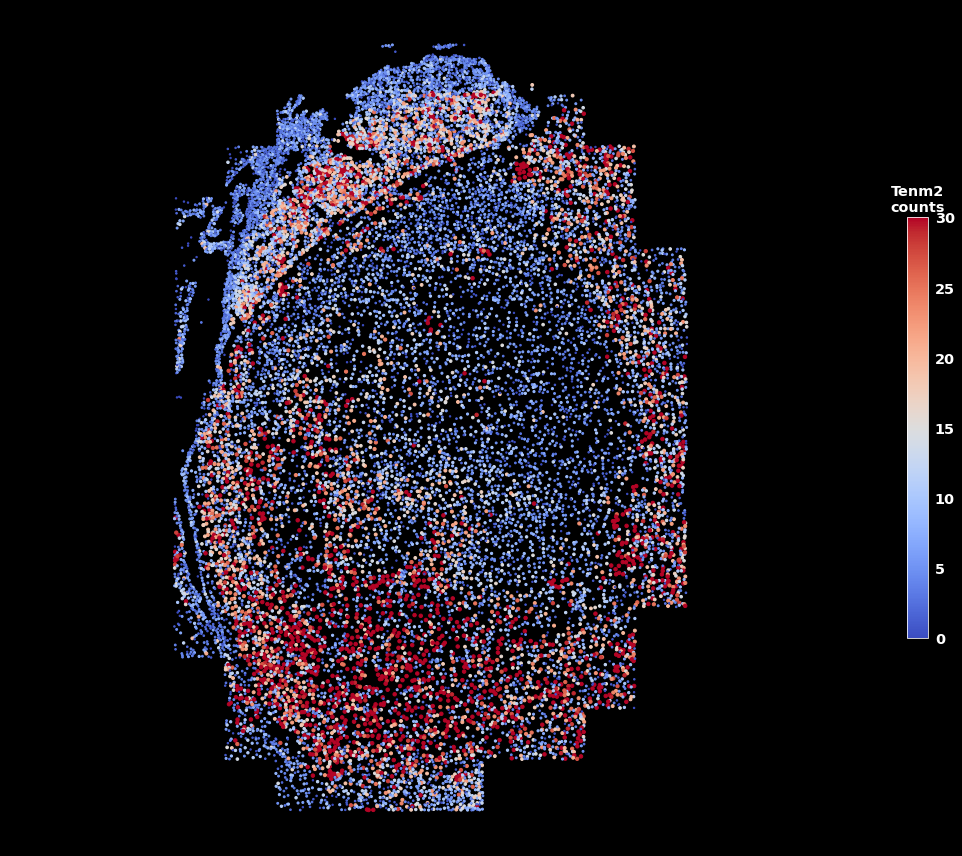

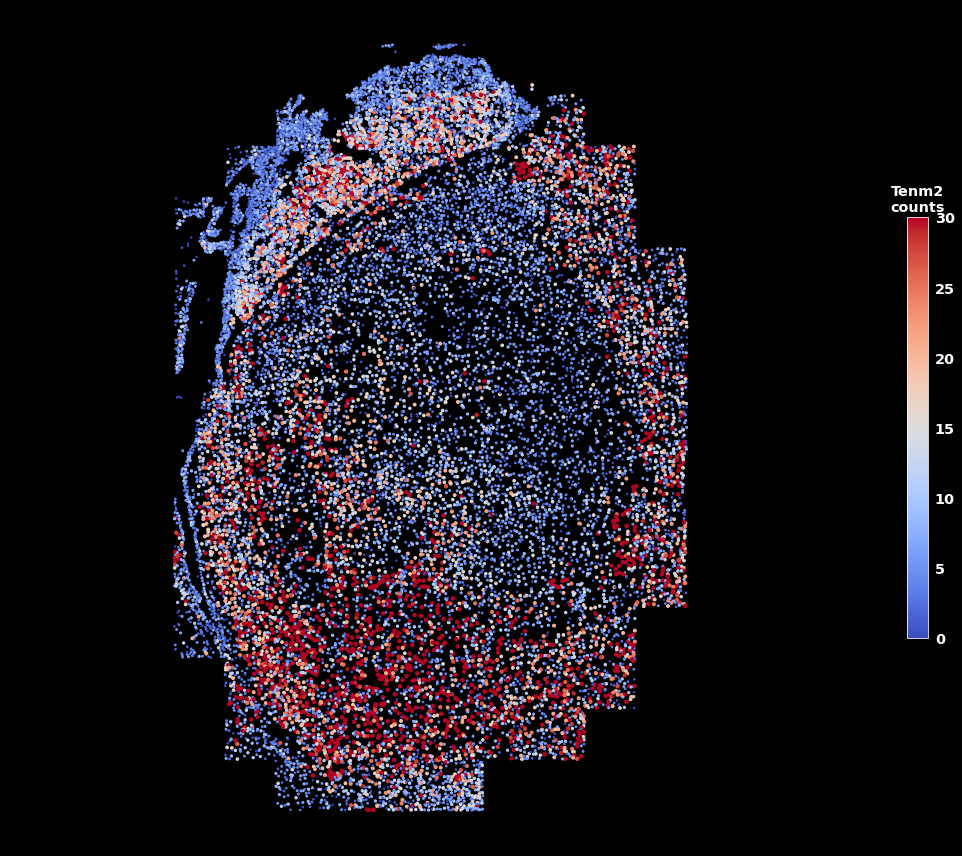

In [381]:
for key in all_keys:
    #print(key,dic_annot[key])
    save_fl = rna_.save_fld+os.sep+key+'_bad_cells.npy'
    if not os.path.exists(save_fl):
        find_cells_next_to_artifacts(rna_,key,save=True,plt_val=True,th_h=0.5,resc=10,eps=30,min_samples=1100)
        plt.show()

### Save and patch artifacts

In [382]:
save_fld = rna_.save_fld
pickle.dump(rna_.dic_cells_final,open(save_fld+os.sep+'dic_cells_final_V3.pkl','wb'))

In [383]:
pickle.dump(rna_.dic_count,open(save_fld+os.sep+'dic_count_V3.pkl','wb'))

In [384]:
#dic_count = rna_.dic_count
from copy import deepcopy
dic_count = deepcopy(rna_.dic_count)

all_keys = np.unique([list(dic_count[cell].keys()) for cell in dic_count.keys()])
all_keys
for Q in all_keys:
    save_fl = rna_.save_fld+os.sep+Q+'_bad_cells.npy'
    bad_cells = np.load(save_fl)
    for cell in bad_cells:
        dic_count[cell][Q]=np.nan
pickle.dump(dic_count,open(save_fld+os.sep+'dic_count_V3_nan.pkl','wb'))

In [385]:
def complete_nan_dic_count(dic_count):
    #print("Correcting the cells in those fovs...")
    #dic_count = dic_ct_cor
    cells = list(dic_count.keys())
    cell = cells[0]
    dicT = dic_count[cell]
    if type(dicT) is dict:
        qs = list(dic_count[cell].keys())
    else:
        qs = np.arange(len(dic_count[cell]))#
    X = np.array([[dic_count[cell][q] for q in qs]for cell in cells])
    bad_ = np.any(np.isnan(X),axis=1)
    cells_bad = np.where(bad_)[0]
    cells_good = np.where(~bad_)[0]

    X_ = X#/np.nansum(X,axis=-1)[:,np.newaxis]
    X_bad_ = X_[cells_bad]
    X_good_ = X_[cells_good]

    from scipy.stats import zscore
    X_good_z = zscore(X_good_,axis=0)
    X_bad_z = (X_bad_-np.nanmean(X_bad_,axis=0))/np.nanstd(X_bad_,axis=0)
    X_bad_z[np.isnan(X_bad_z)]=0

    from scipy.spatial import cKDTree as kdtree
    tree = kdtree(X_good_z)
    dist,best_cells = tree.query(X_bad_z,10,workers=30);
    X_copy = X.copy()
    Xgood_close = np.nanmedian(X[cells_good][best_cells],axis=1)
    bad_inds = np.isnan(X_bad_)

    Xgood_close_ = Xgood_close.copy()
    Xgood_close_[bad_inds]=np.nan
    nsums_close = np.nansum(Xgood_close_,axis=-1)[:,np.newaxis]
    nsums_bad = np.nansum(X_bad_,axis=-1)[:,np.newaxis]
    Xgood_close_ = Xgood_close/nsums_close*nsums_bad
    Xgood_close_[np.isnan(Xgood_close_)]=0
    Xgood_close_[np.isinf(Xgood_close_)]=0
    X_copy[np.isnan(X_copy)]=Xgood_close_[bad_inds]

    for icell,cell in tqdm(enumerate(cells)):
        for iq,q in enumerate(qs):
            dic_count[cell][q] = X_copy[icell,iq]
    return dic_count

In [386]:
complete_nan_dic_count(dic_count)

<ipython-input-385-ee2cbe4d2764>:41: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for icell,cell in tqdm(enumerate(cells)):


0it [00:00, ?it/s]

{120006: {'Q1': 1.0,
  'Q10': 1.0,
  'Q100': 2.0,
  'Q101': 1.0,
  'Q102': 0.0,
  'Q103': 4.0,
  'Q104': 0.0,
  'Q105': 2.0,
  'Q11': 2.0,
  'Q12': 0.0,
  'Q13': 0.0,
  'Q14': 0.0,
  'Q15': 0.0,
  'Q16': 1.0,
  'Q17': 0.0,
  'Q18': 3.0,
  'Q19': 2.0,
  'Q2': 1.0,
  'Q20': 0.0,
  'Q21': 0.0,
  'Q22': 1.0,
  'Q23': 0.0,
  'Q24': 0.0,
  'Q25': 0.0,
  'Q26': 1.0,
  'Q27': 1.0,
  'Q28': 0.0,
  'Q29': 2.0,
  'Q3': 8.0,
  'Q30': 6.0,
  'Q31': 0.0,
  'Q32': 0.0,
  'Q33': 0.0,
  'Q34': 4.0,
  'Q35': 0.0,
  'Q36': 4.0,
  'Q4': 0.0,
  'Q5': 1.0,
  'Q6': 1.0,
  'Q7': 15.0,
  'Q8': 0.0,
  'Q9': 0.0},
 120008: {'Q1': 0.0,
  'Q10': 0.0,
  'Q100': 18.0,
  'Q101': 1.0,
  'Q102': 0.0,
  'Q103': 7.0,
  'Q104': 0.0,
  'Q105': 10.0,
  'Q11': 3.0,
  'Q12': 0.0,
  'Q13': 4.0,
  'Q14': 1.0,
  'Q15': 2.0,
  'Q16': 10.0,
  'Q17': 0.0,
  'Q18': 4.0,
  'Q19': 6.0,
  'Q2': 0.0,
  'Q20': 9.0,
  'Q21': 20.0,
  'Q22': 1.0,
  'Q23': 12.0,
  'Q24': 6.0,
  'Q25': 1.0,
  'Q26': 25.0,
  'Q27': 46.0,
  'Q28': 3.0,
  'Q29':

In [387]:
pickle.dump(dic_count,open(save_fld+os.sep+'dic_count_V3_nan_patched.pkl','wb'))

In [388]:
print(save_fld)

\\MERFISH6.ucsd.edu\merfish6v2\DNA_FISH\20230122_R120PVTS32RDNA_Analysis


### Umap scanpy

In [353]:
print(dic_annot)

{'Gfap': 'Q1', 'Q1': 'Gfap', 'Cspg4': 'Q2', 'Q2': 'Cspg4', 'Olig1': 'Q3', 'Q3': 'Olig1', 'Cx3cr1': 'Q4', 'Q4': 'Cx3cr1', 'Gja1': 'Q5', 'Q5': 'Gja1', 'Pdgfra': 'Q6', 'Q6': 'Pdgfra', 'Flt1': 'Q7', 'Q7': 'Flt1', 'Gad1': 'Q8', 'Q8': 'Gad1', 'Tmem212': 'Q9', 'Q9': 'Tmem212', 'Aqp4': 'Q10', 'Q10': 'Aqp4', 'Cadps2': 'Q11', 'Q11': 'Cadps2', 'P2ry12': 'Q12', 'Q12': 'P2ry12', 'Rbfox3': 'Q13', 'Q13': 'Rbfox3', 'Dcc': 'Q14', 'Q14': 'Dcc', 'Mog': 'Q15', 'Q15': 'Mog', 'Slc17a7': 'Q16', 'Q16': 'Slc17a7', 'Il1rapl2': 'Q17', 'Q17': 'Il1rapl2', 'Mobp': 'Q18', 'Q18': 'Mobp', 'Col25a1': 'Q19', 'Q19': 'Col25a1', 'Lrrtm4': 'Q20', 'Q20': 'Lrrtm4', 'Fos': 'Q21', 'Q21': 'Fos', 'Dab1': 'Q22', 'Q22': 'Dab1', 'Mgat4c': 'Q23', 'Q23': 'Mgat4c', 'Cntnap5b': 'Q24', 'Q24': 'Cntnap5b', 'Hs3st4': 'Q25', 'Q25': 'Hs3st4', 'Pde10a': 'Q26', 'Q26': 'Pde10a', 'Ldb2': 'Q27', 'Q27': 'Ldb2', 'Hs6st3': 'Q28', 'Q28': 'Hs6st3', 'Sdk1': 'Q29', 'Q29': 'Sdk1', 'Sema6d': 'Q30', 'Q30': 'Sema6d', 'Kirrel3': 'Q31', 'Q31': 'Kirrel3', 'Sgcz

In [354]:
import sys,os
import numpy as np, matplotlib.pyplot as plt
import numpy
import pickle
import imp
import glob
from PIL import Image
import tifffile
from tqdm import tqdm_notebook as tqdm

import scanpy as sc
from scipy.stats import zscore
import numpy as np
import pandas as pd

save_fld = r'\\MERFISH6.ucsd.edu\merfish6v2\DNA_FISH\20230122_R120PVTS32RDNA_Analysis'

dic_count = pickle.load(open(save_fld+os.sep+'dic_count_V3_nan_patched.pkl','rb'))
dic_cells_final = pickle.load(open(save_fld+os.sep+'dic_cells_final_V3.pkl','rb'))
cells = list(dic_count.keys())
#genes = np.unique([Q for cell in cells for Q in dic_count[cell].keys()])
#genes = #['Q'+str(i+1) for i in range(48)]#+['G14','G15','G18','G21']
allQs = np.unique([q for cell in dic_count for q in dic_count[cell].keys()])
genes = allQs
#genes = [q for q in allQs if 'B' not in q and 'I' not in q]
dic_annot = {'Gfap': 'Q1', 'Q1': 'Gfap', 'Cspg4': 'Q2', 'Q2': 'Cspg4', 'Olig1': 'Q3', 'Q3': 'Olig1', 'Cx3cr1': 'Q4', 'Q4': 'Cx3cr1', 'Gja1': 'Q5', 'Q5': 'Gja1', 'Pdgfra': 'Q6', 'Q6': 'Pdgfra', 'Flt1': 'Q7', 'Q7': 'Flt1', 'Gad1': 'Q8', 'Q8': 'Gad1', 'Tmem212': 'Q9', 'Q9': 'Tmem212', 'Aqp4': 'Q10', 'Q10': 'Aqp4', 'Cadps2': 'Q11', 'Q11': 'Cadps2', 'P2ry12': 'Q12', 'Q12': 'P2ry12', 'Rbfox3': 'Q13', 'Q13': 'Rbfox3', 'Dcc': 'Q14', 'Q14': 'Dcc', 'Mog': 'Q15', 'Q15': 'Mog', 'Slc17a7': 'Q16', 'Q16': 'Slc17a7', 'Il1rapl2': 'Q17', 'Q17': 'Il1rapl2', 'Mobp': 'Q18', 'Q18': 'Mobp', 'Col25a1': 'Q19', 'Q19': 'Col25a1', 'Lrrtm4': 'Q20', 'Q20': 'Lrrtm4', 'Fos': 'Q21', 'Q21': 'Fos', 'Dab1': 'Q22', 'Q22': 'Dab1', 'Mgat4c': 'Q23', 'Q23': 'Mgat4c', 'Cntnap5b': 'Q24', 'Q24': 'Cntnap5b', 'Hs3st4': 'Q25', 'Q25': 'Hs3st4', 'Pde10a': 'Q26', 'Q26': 'Pde10a', 'Ldb2': 'Q27', 'Q27': 'Ldb2', 'Hs6st3': 'Q28', 'Q28': 'Hs6st3', 'Sdk1': 'Q29', 'Q29': 'Sdk1', 'Sema6d': 'Q30', 'Q30': 'Sema6d', 'Kirrel3': 'Q31', 'Q31': 'Kirrel3', 'Sgcz': 'Q32', 'Q32': 'Sgcz', 'Tafa2': 'Q33', 'Q33': 'Tafa2', 'Scg2': 'Q34', 'Q34': 'Scg2', 'Bdnf': 'Q35', 'Q35': 'Bdnf', 'Tenm2': 'Q36', 'Q36': 'Tenm2', 'Q103': 'Cox6a1', 'Q104': 'Ecel1', 'Q105': 'Cbln2', 'Q100': 'Gria1', 'Cox6a1': 'Q103', 'Ecel1': 'Q104', 'Cbln2': 'Q105', 'Gria1': 'Q100'}
genes_names=[dic_annot.get(gn) for gn in genes]#['Adarb2', 'Apod', 'Atp1a2', 'C1ql3', 'Cacnb2', 'Cald1', 'Camk2d', 'Camk2n1', 'Cdh18', 'Cnr1', 'Cst3', 'Cttnbp2', 'Dab1', 'Dcc', 'Dcn', 'Flt1', 'Fras1', 'Gad2', 'Hs3st2', 'Hs3st4', 'Il1rapl2', 'Kcnc2', 'Kcnq5', 'Mef2c', 'Meis2', 'Mt1', 'Ndnf', 'Ndst4', 'Nnat', 'Nos1', 'Nr4a2', 'Nrep', 'Ntng1', 'Ppfia2', 'Ptprd', 'Qk', 'Rbms3', 'Sgcd', 'Slc6a1', 'Sst', 'Tafa1', 'Tafa2', 'Trps1', 'Tshz2', 'Wfs1', 'Wipf3', 'Zbtb20', 'Zfpm2']

dic_Q_to_gene = {gn:gn_nm for gn,gn_nm in zip(genes,genes_names)}
dic_gene_to_Q = {gn_nm:gn for gn,gn_nm in zip(genes,genes_names)}

cells = list(dic_count.keys())
data = np.array([[dic_count[cell][gene]for gene in genes]for cell in cells])
count_table2 = pd.DataFrame(data=data, index=cells, columns=genes)
cells = list(dic_count.keys())
data = [list(dic_cells_final[cell]['X'][1:])+[dic_cells_final[cell]['volume']] for cell in dic_cells_final]
celldata2 = pd.DataFrame(data=data, index=cells, columns=['global_x','global_y','volume'])


scdata2 = sc.AnnData(count_table2)
scdata2.obsm["X_spatial"] = np.array(
    celldata2[["global_x", "global_y"]].reindex(
        index=scdata2.obs.index.astype(int)
    )
)
sc.pp.filter_cells(scdata2, min_genes=5)
scdata2.obsm["X_raw"] = scdata2.X.copy()
sc.pp.calculate_qc_metrics(scdata2, percent_top=None, inplace=True)
sc.pp.normalize_total(scdata2, target_sum=np.median(scdata2.obs["total_counts"]))


ModuleNotFoundError: No module named 'scanpy'

array(['Q1', 'Q10', 'Q100', 'Q101', 'Q102', 'Q103', 'Q104', 'Q105', 'Q11',
       'Q12', 'Q13', 'Q14', 'Q15', 'Q16', 'Q17', 'Q18', 'Q19', 'Q2',
       'Q20', 'Q21', 'Q22', 'Q23', 'Q24', 'Q3', 'Q4', 'Q5', 'Q6', 'Q7',
       'Q8', 'Q9'], dtype='<U4')

In [342]:

Q = dic_annot['Mog']
save_fl = rna_.save_fld+os.sep+Q+'_bad_cells.npy'
bad_cells = np.load(save_fl)
plot_gene_expression(rna_,Q,bad_cells=bad_cells,vmax=6,szmin=2,szmax=10)

In [ ]:
for

In [50]:
%matplotlib inline

In [11]:
dic_count = rna_.dic_count
all_keys = np.unique([list(dic_count[cell].keys()) for cell in dic_count.keys()])
all_keys

AttributeError: 'RNA_analyzer' object has no attribute 'dic_count'

In [12]:
#Q='Q3'
dic_count = rna_.dic_count
all_keys = np.unique([list(dic_count[cell].keys()) for cell in dic_count.keys()])
#all_keys=['Q1']
for Q in all_keys:
    find_cells_next_to_artifacts(rna_,Q,save=True,plt_val=True)

AttributeError: 'RNA_analyzer' object has no attribute 'dic_count'

In [ ]:
pickle.dump(rna_.dic_count,open(save_fld+os.sep+'dic_count_nan_V3.pkl','wb'))

In [29]:
%matplotlib notebook

In [ ]:
dic_count_ = pickle.load(open(save_fld+os.sep+'dic_count_nan_V3.pkl','rb'))
save_fld = os.path.dirname(rna_.fls[0])
allQs = np.unique([q for cell in dic_count_ for q in dic_count_[cell].keys()])
for Q in allQs:
    bad_cells = np.load(save_fld+os.sep+Q+'_bad_cells.npy') 
    for cell in bad_cells:
        if cell in dic_count_:
            dic_count_[cell][Q] = np.nan
dic_count_ = complete_nan_dic_count(dic_count_)

In [ ]:
pickle.dump(dic_count_,open(save_fld+os.sep+'dic_count_corrected_V3.pkl','wb'))

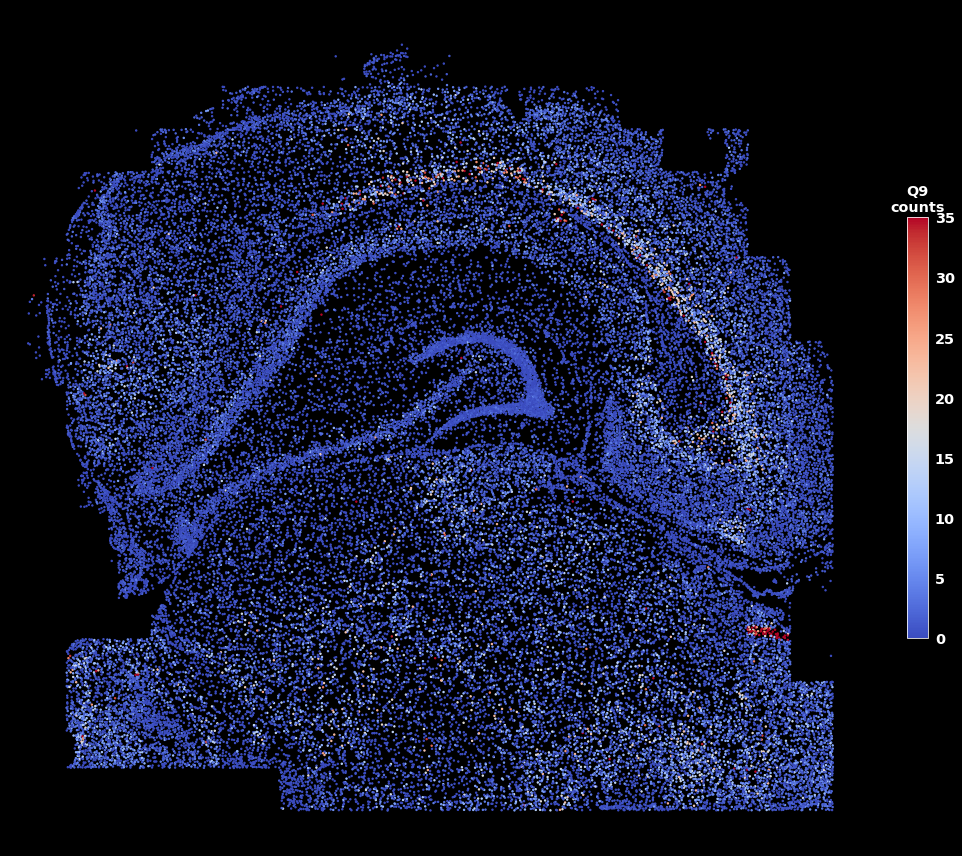

In [35]:
Q='Q9'
rna_.dic_count = dic_count_
save_fld = os.path.dirname(rna_.fls[0])
save_fl = save_fld+os.sep+Q+'_bad_cells.npy'
bad_cells = np.load(save_fl)

plot_gene_expression(rna_,Q,bad_cells=[],vmax=35,vmax_perc=None,name=None)

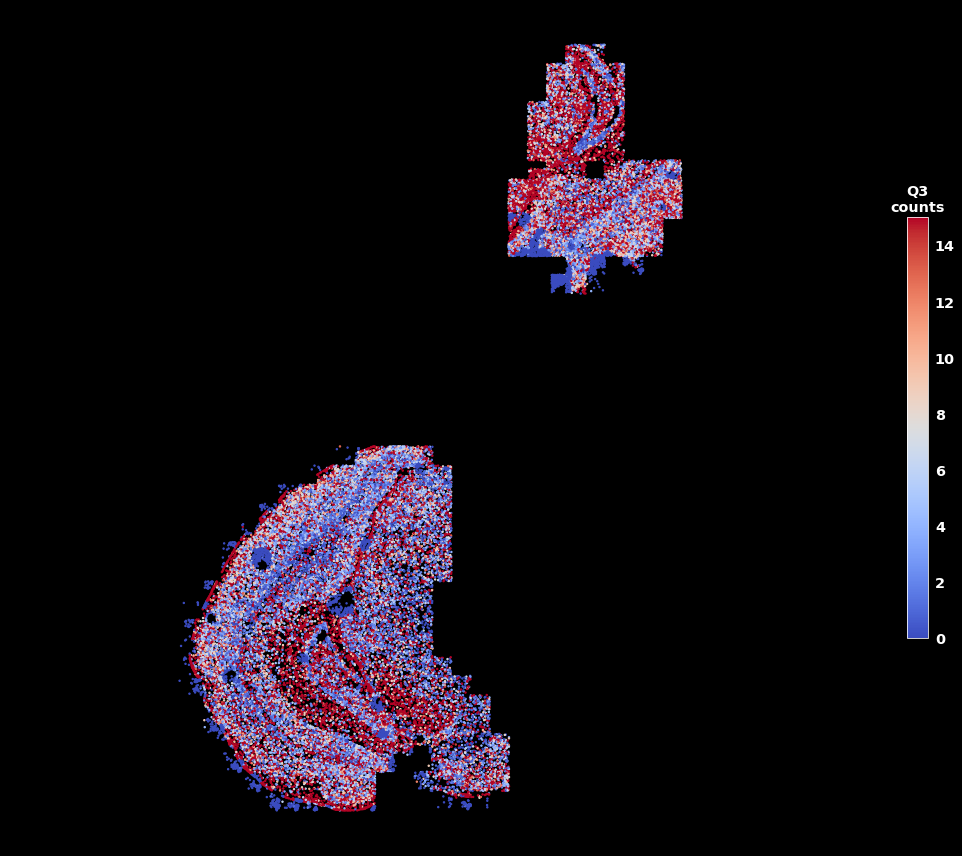

In [57]:
Q='Q3'
rna_.dic_count = dic_count_
save_fld = os.path.dirname(rna_.fls[0])
save_fl = save_fld+os.sep+Q+'_bad_cells.npy'
bad_cells = np.load(save_fl)

plot_gene_expression(rna_,Q,bad_cells=[],vmax=15,vmax_perc=None,name=None)

In [29]:
#pickle.dump(rna_.dic_count,open(save_fld+os.sep+'dic_count_V2.pkl','wb'))

In [66]:
pickle.dump(rna_.dic_cells_final,open(save_fld+os.sep+'dic_cells_final_V2.pkl','wb'))

# START HERE!

In [14]:
import sys,os
import numpy as np, matplotlib.pyplot as plt
import numpy
import pickle
import imp
import glob
from PIL import Image
import tifffile
from tqdm import tqdm_notebook as tqdm

import scanpy as sc
from scipy.stats import zscore
import numpy as np
import pandas as pd

save_fld = r'\\132.239.201.25\Raw_data\Glass_MERFISH\CGBB_6_10_2022_KO_Analysis_v5'

dic_count = pickle.load(open(save_fld+os.sep+'dic_count_corrected_V3.pkl','rb'))
dic_cells_final = pickle.load(open(save_fld+os.sep+'dic_cells_final_V3.pkl','rb'))
genes = ['Q'+str(i+1) for i in range(48)]#+['G14','G15','G18','G21']
allQs = np.unique([q for cell in dic_count for q in dic_count[cell].keys()])
genes = allQs
genes = [q for q in allQs if 'B' not in q and 'I' not in q]
genes_names=['Adarb2', 'Apod', 'Atp1a2', 'C1ql3', 'Cacnb2', 'Cald1', 'Camk2d', 'Camk2n1', 'Cdh18', 'Cnr1', 'Cst3', 'Cttnbp2', 'Dab1', 'Dcc', 'Dcn', 'Flt1', 'Fras1', 'Gad2', 'Hs3st2', 'Hs3st4', 'Il1rapl2', 'Kcnc2', 'Kcnq5', 'Mef2c', 'Meis2', 'Mt1', 'Ndnf', 'Ndst4', 'Nnat', 'Nos1', 'Nr4a2', 'Nrep', 'Ntng1', 'Ppfia2', 'Ptprd', 'Qk', 'Rbms3', 'Sgcd', 'Slc6a1', 'Sst', 'Tafa1', 'Tafa2', 'Trps1', 'Tshz2', 'Wfs1', 'Wipf3', 'Zbtb20', 'Zfpm2']
dic_Q_to_gene = {gn:gn_nm for gn,gn_nm in zip(genes,genes_names)}
dic_gene_to_Q = {gn_nm:gn for gn,gn_nm in zip(genes,genes_names)}

cells = list(dic_count.keys())
data = np.array([[dic_count[cell][gene]for gene in genes]for cell in cells])
count_table2 = pd.DataFrame(data=data, index=cells, columns=genes)
cells = list(dic_count.keys())
data = [list(dic_cells_final[cell]['X'][1:])+[dic_cells_final[cell]['volume']] for cell in dic_cells_final]
celldata2 = pd.DataFrame(data=data, index=cells, columns=['global_x','global_y','volume'])


scdata2 = sc.AnnData(count_table2)
scdata2.obsm["X_spatial"] = np.array(
    celldata2[["global_x", "global_y"]].reindex(
        index=scdata2.obs.index.astype(int)
    )
)
sc.pp.filter_cells(scdata2, min_genes=5)
scdata2.obsm["X_raw"] = scdata2.X.copy()
sc.pp.calculate_qc_metrics(scdata2, percent_top=None, inplace=True)
sc.pp.normalize_total(scdata2, target_sum=np.median(scdata2.obs["total_counts"]))


C:\ProgramData\Anaconda3\lib\site-packages\anndata\_core\anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


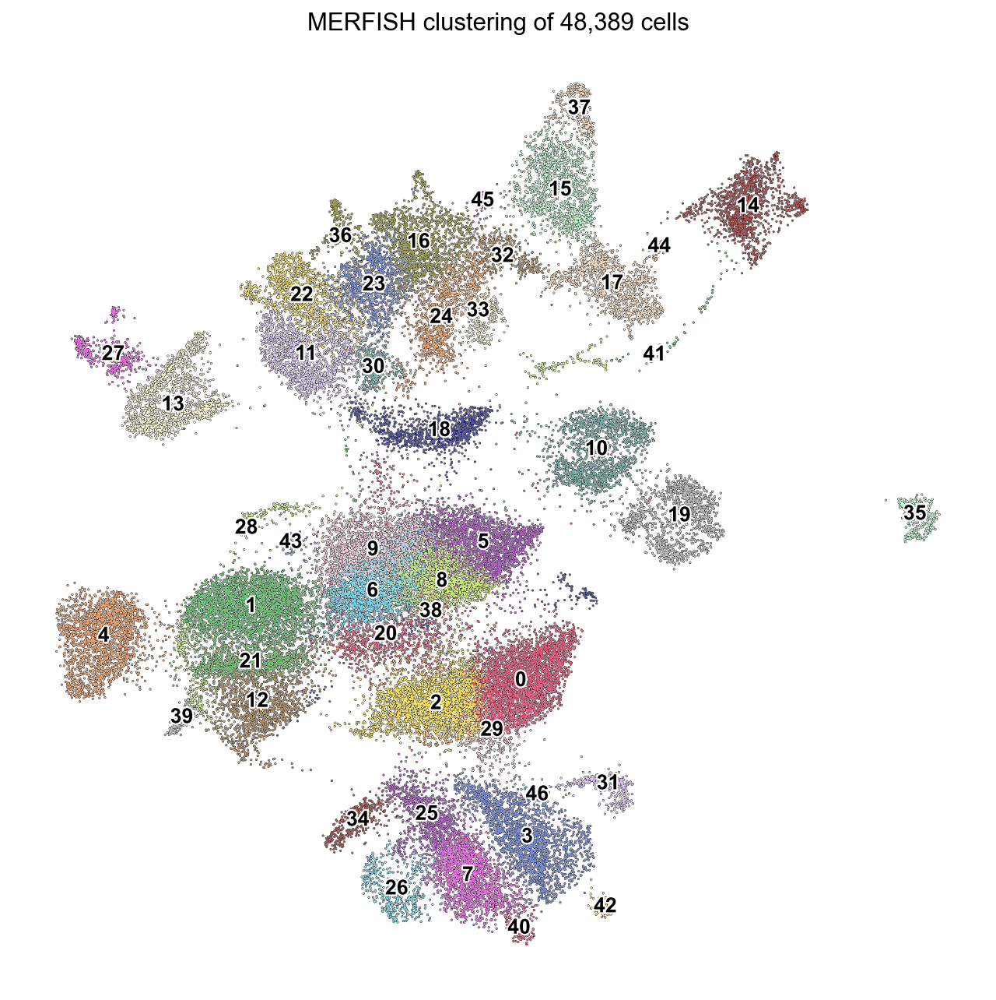

In [15]:
### Tried volume normalization but did not work well.

#volume = np.array(list(celldata['volume'].reindex(index=scdata.obs.index.astype(int))),dtype=np.float)
#scdata.X = scdata.X/volume[:,np.newaxis]*np.median(volume)



sc.pp.log1p(scdata2)

#scdata2.X = scdata2.to_df().apply(zscore, axis=0).to_numpy()

### Should we use PCA?

### Should we do z-scores. Explore this with spatial maps. Visual inspection.

sc.pp.neighbors(scdata2,use_rep = "X")  #metric='correlation', use_rep = "X"
sc.tl.leiden(scdata2, resolution=3) #### 
#plt.figure()
sc.tl.umap(scdata2,random_state=9)
cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
        "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
        "#000075", "#a9a9a9"]

sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata2,
    color="leiden",
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
    frameon=False,
    title=f"MERFISH clustering of {len(scdata2):,d} cells",
    palette=cmap
)

In [3]:

save_fld = r'\\BBFISH2\Raw_data_2\Glass_MERFISH\CGBB_5_06_2022_Analysis_v5'
sc.write(save_fld+os.sep+'MERFISH_scdata.h5',scdata2)

In [46]:
#cmap = ["#e6194B","#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
#        "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
#        "#000075", "#a9a9a9"]
def plt_clusters(clusters = ['0']):
    import matplotlib.pyplot as plt
    plt.figure(figsize=(15, 15), facecolor="black")

    from matplotlib import pylab as plt


    scdata = scdata2
    x = -scdata.obsm['X_spatial'][:, 0]
    y = -scdata.obsm['X_spatial'][:, 1]
    plt.scatter(x, y, c='w', s=1, marker='.')

    """
    #clusters = ['6','1','9','0']
    clusters = np.unique(scdata.obs["leiden"])
    #clusters = ['27']
    clusters,ccts = np.unique(scdata.obs["leiden"],return_counts=True)
    clusters = clusters[np.argsort(ccts)]



    clusters = ['41','47','37','42','33','15','13','4','43','53','20']
    clusters=['13']#18,23,42,9
    """
    for cluster in clusters:#[::-1][:20]:#np.unique(scdata.obs["leiden"]):

        inds = scdata.obs[scdata.obs["leiden"] == cluster].index
        x = -scdata[inds].obsm['X_spatial'][:, 0]
        y = -scdata[inds].obsm['X_spatial'][:, 1]
        plt.scatter(x, y,  s=20, marker='o',label=cluster,c=cmap[int(cluster) % 20])
        #plt.text(np.median(x),np.median(y),cluster,color='w',fontsize=20)
        plt.legend()
    plt.grid(b=False)
    plt.axis("off")
    plt.axis("equal")
    plt.tight_layout()

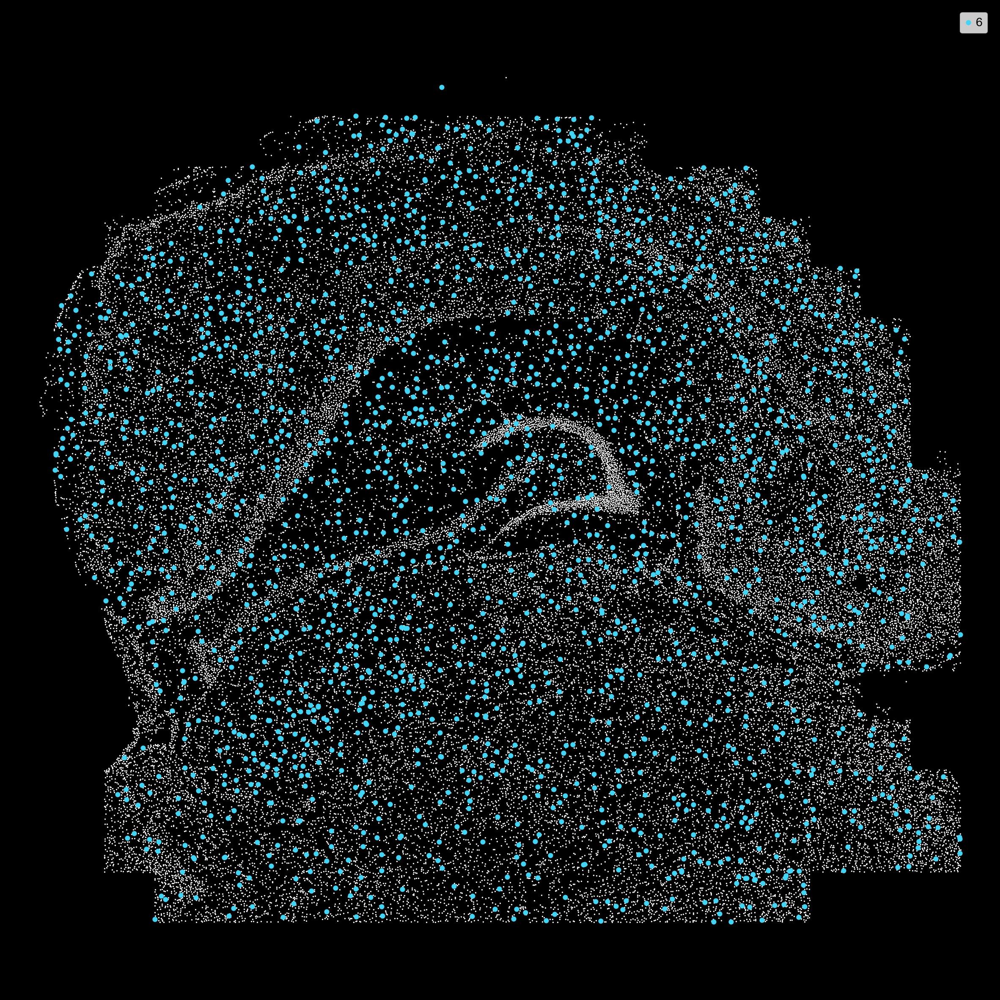

In [30]:
plt_clusters(clusters = ['6'])

C:\Users\Bogdan\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [8]:
!dir

 Volume in drive C is Windows
 Volume Serial Number is 7E84-B502

 Directory of C:\Users\glasslab\Dropbox\ChrisGlass_Project\ChromatinAnalysisV2\Scope1_Python_Scripts

05/03/2022  06:18 PM    <DIR>          .
05/03/2022  06:18 PM    <DIR>          ..
05/03/2022  02:40 PM    <DIR>          .ipynb_checkpoints
04/17/2022  02:30 PM    <DIR>          CommonTools
04/17/2022  02:30 PM    <DIR>          dask-worker-space
03/31/2022  11:00 AM         7,746,341 Example_load_zarr.ipynb
01/31/2022  04:37 PM           417,700 FFT for image alignment.ipynb
12/20/2021  05:08 PM        31,106,736 image.tif
04/27/2022  06:54 PM             3,332 microglia_cells.npy
12/18/2021  11:12 AM            11,232 MosaicToolsPy3.py
08/28/2021  08:33 PM            11,192 MosaicToolsPy3.py.bak
12/20/2021  11:25 AM        30,859,345 Mosaic_20211207_R80S13__CBM4Real.ipynb
02/15/2022  07:48 AM         9,621,707 Mosaic_CGBB_1_20_2022-Copy1.ipynb
02/12/2022  08:33 AM         8,844,607 Mosaic_CGBB_1_20_2022-Copy2.ipynb
0

In [19]:
### define the genes used Q1,2,3;G1,2,3... - > genes
genes = ['Q'+str(i+1) for i in range(48)]
genes_names=['Adarb2', 'Apod', 'Atp1a2', 'C1ql3', 'Cacnb2', 'Cald1', 'Camk2d', 'Camk2n1', 'Cdh18', 'Cnr1', 'Cst3', 'Cttnbp2', 'Dab1', 'Dcc', 'Dcn', 'Flt1', 'Fras1', 'Gad2', 'Hs3st2', 'Hs3st4', 'Il1rapl2', 'Kcnc2', 'Kcnq5', 'Mef2c', 'Meis2', 'Mt1', 'Ndnf', 'Ndst4', 'Nnat', 'Nos1', 'Nr4a2', 'Nrep', 'Ntng1', 'Ppfia2', 'Ptprd', 'Qk', 'Rbms3', 'Sgcd', 'Slc6a1', 'Sst', 'Tafa1', 'Tafa2', 'Trps1', 'Tshz2', 'Wfs1', 'Wipf3', 'Zbtb20', 'Zfpm2']
genes_namesG=['Alox5ap', 'Apoc1', 'Apoe', 'Axl', 'B2m', 'Ccl4', 'Cd33', 'Cd63', 'Cd74', 'Cd86', 'Cd9', 'Cebpa', 'Csf1', 'Csf1r', 'Cx3cr1', 'Cybb', 'Dab2', 'Egr1', 'F13a1', 'Frmd4a', 'Fth1', 'Gas6', 'H2-DMa', 'H2-K1', 'Hs3st1', 'Ier2', 'Ifitm3', 'Il1a', 'Inpp5d', 'Jun', 'Kif11', 'Klk8', 'Lyve1', 'Lyz2', 'Mki67', 'Mrc1', 'Mx1', 'Nav2', 'Nfkbia', 'P2ry12', 'Pacsin1', 'Pf4', 'Pla2g7', 'Plxdc2', 'Rara', 'Sall1', 'Spi1', 'Spp1', 'Tlr3', 'Tlr4', 'Tlr8', 'Tmem119', 'Top2a', 'Trem2', 'Tyrobp']
genesG = ['G'+str(i+1) for i in range(len(genes_namesG))]
genes+=genesG
genes_names+=genes_namesG
dic_Q_to_gene = {gn:gn_nm for gn,gn_nm in zip(genes,genes_names)}
dic_gene_to_Q = {gn_nm:gn for gn,gn_nm in zip(genes,genes_names)}
#dic_gene_to_Q['Sall1']

### load in the Alen brain data (Cell 2020 paper)
import scanpy as sc
scdata_seq = sc.read(r'..\..\scRNAseq\subsampled_to_500cellsPerCLuster.h5ad')
mean_counts_gene =  np.array(np.mean(scdata_seq.X,axis=0)).squeeze()
allgenes = scdata_seq.var.index
keep = np.in1d(allgenes,genes_names)
scdata_seq_sub = scdata_seq[:,keep]
label = scdata_seq.obs['label']
ulabel = np.unique(label)
ulabel_seq = ulabel
label_seq = label
genes_seq = list(scdata_seq_sub.var.index)
M = np.squeeze([np.mean(scdata_seq_sub[label==ul].X.toarray(),0) for ul in ulabel])
Mzscore_seq = zscore(M,axis=0)


### reconfigure the MERFISH data

cells = list(dic_count.keys())
data = np.array([[dic_count[cell][gene]for gene in genes]for cell in cells])
count_table2 = pd.DataFrame(data=data, index=cells, columns=genes_names)
scdata2_raw = sc.AnnData(count_table2)
sc.pp.filter_cells(scdata2_raw, min_genes=5)
sc.pp.calculate_qc_metrics(scdata2_raw, percent_top=None, inplace=True)
sc.pp.normalize_total(scdata2_raw, target_sum=np.median(scdata2_raw.obs["total_counts"]))
sc.pp.log1p(scdata2_raw)

########### compare datasets to impute annotation onto our clusters

genes_fish = genes_names#[dic_Q_to_gene[q_]for q_ in scdata2_raw.var.index]
scdata_fish = scdata2_raw[:,[genes_fish.index(gn) for gn in genes_seq]]
label = scdata2.obs['leiden']
label_fish = label
ulabel = np.unique(label)
ulabel_fish = ulabel
M = np.squeeze([np.mean(scdata_fish[label==ul].X.toarray(),0) for ul in ulabel])
Mzscore_fish = zscore(M,axis=0)

from scipy.spatial.distance import cdist
cors = 1-cdist((Mzscore_fish>0).astype(float),(Mzscore_seq>0).astype(float),metric='correlation')
#cors = -cdist(Mzscore_fish,Mzscore_seq)
dic_best_guess={}
for il in ulabel_fish:
    cors_sq = cors[ulabel_fish==il].squeeze()
    print(il,np.sum(label_fish==il),cors_sq[np.nanargmax(cors_sq)],ulabel_seq[np.argmax(cors_sq)])
    dic_best_guess[il]=(np.sum(label_fish==il),cors_sq[np.nanargmax(cors_sq)],ulabel_seq[np.argmax(cors_sq)])


C:\ProgramData\Anaconda3\lib\site-packages\anndata\_core\anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


0 3370 0.6894298263792304 Astro
1 3341 0.35151858735986674 Oligo
10 1606 0.17756541592262742 Ndnf HPF
11 1594 0.4461679544985262 Pvalb
12 1545 0.39180637934720064 Car3
13 1488 0.34722975045459115 L2/3 IT ProS
14 1447 0.4754509857458954 L6 CT CTX
15 1425 0.5071691650934621 DG
16 1286 0.5773555866410929 CA3
17 1224 0.4296731749132172 L2 IT PAR
18 1145 0.46939358622027494 Ndnf HPF
19 1140 0.5466009111992935 L2/3 IT ENTl
2 2866 0.29930319646169923 L5 NP CT CTX 
20 1082 0.5386792768600521 L2/3 IT HATA
21 981 0.5562294826316383 Micro-PVM
22 976 0.3652480665500756 Micro-PVM
23 874 0.22395700438234178 L2/3 IT ProS
24 807 0.34188035207414735 L5 PPP
25 581 0.17446723448646273 Micro-PVM
26 538 0.5469484538236596 L2/3 IT CTX
27 535 0.25805161331482773 Micro-PVM
28 459 0.41657639169055305 L6 IT ENTl
29 458 0.2634680716099971 L2 IT ENTl
3 2373 0.4355402566422051 Micro-PVM
30 407 0.38293263297779434 L6b CTX
31 392 0.30574780061013607 CA3
32 387 0.24170814605263224 L2/3 IT HATA
33 368 0.37998494727790

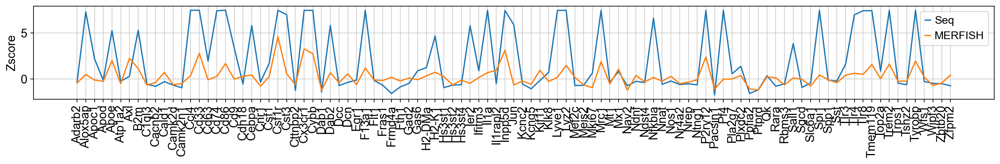

In [42]:
inds = np.argsort(genes_seq)
plt.figure(figsize=(20,2))
plt.plot(Mzscore_seq[list(ulabel_seq).index('Micro-PVM'),inds],label='Seq')#'Astro',Micro-PVM
plt.plot(Mzscore_fish[list(ulabel_fish).index('6'),inds],label='MERFISH')
plt.xticks(np.arange(len(genes_seq)),np.array(genes_seq)[inds],rotation='90');
plt.ylabel('Zscore')
plt.legend()

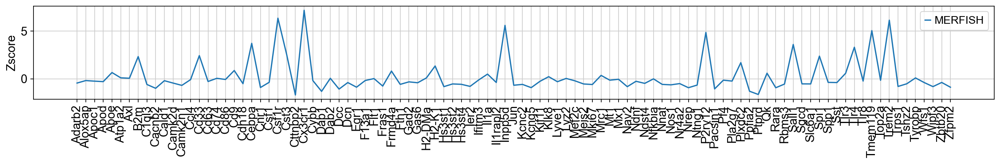

In [7]:
inds = np.argsort(genes_seq)
plt.figure(figsize=(20,2))
#plt.plot(Mzscore_seq[list(ulabel_seq).index('Oligo'),inds],label='Seq')#'Astro',Micro-PVM
plt.plot(Mzscore_fish[list(ulabel_fish).index('9'),inds],label='MERFISH')
plt.xticks(np.arange(len(genes_seq)),np.array(genes_seq)[inds],rotation='90');
plt.ylabel('Zscore')
plt.legend()

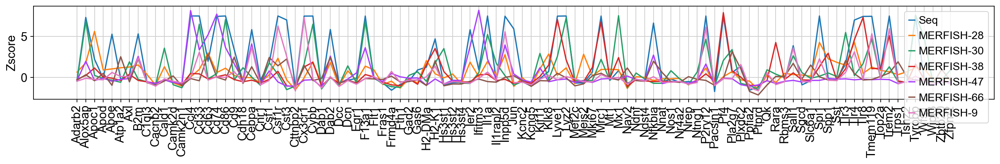

In [119]:
inds = np.argsort(genes_seq)
plt.figure(figsize=(20,2))
plt.plot(Mzscore_seq[list(ulabel_seq).index('Micro-PVM'),inds],label='Seq')#'Astro',Micro-PVM
plt.plot(Mzscore_fish[list(ulabel_fish).index('28'),inds],label='MERFISH-28')
plt.plot(Mzscore_fish[list(ulabel_fish).index('30'),inds],label='MERFISH-30')
plt.plot(Mzscore_fish[list(ulabel_fish).index('38'),inds],label='MERFISH-38')
plt.plot(Mzscore_fish[list(ulabel_fish).index('47'),inds],label='MERFISH-47')
plt.plot(Mzscore_fish[list(ulabel_fish).index('66'),inds],label='MERFISH-66')
plt.plot(Mzscore_fish[list(ulabel_fish).index('9'),inds],label='MERFISH-9')
plt.xticks(np.arange(len(genes_seq)),np.array(genes_seq)[inds],rotation='90');
plt.ylabel('Zscore')
plt.legend()

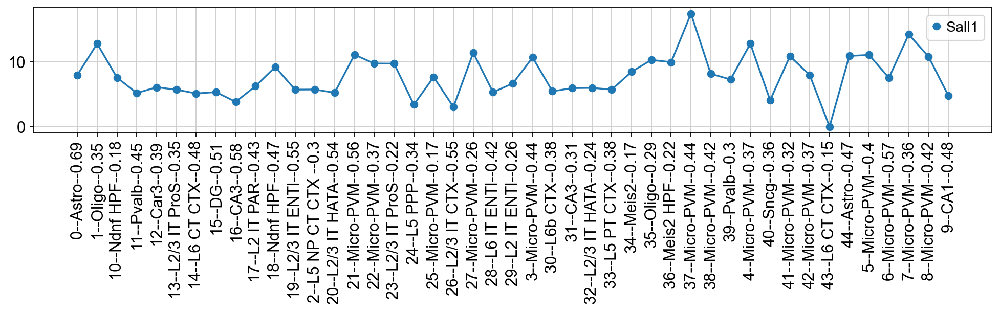

In [44]:
M = np.squeeze([np.mean(scdata_fish[label==ul].X.toarray(),0) for ul in ulabel])
cts = [np.exp(M[list(ulabel).index(cl),genes_seq.index('Sall1')])-1 for cl in ulabel]#Mx1
plt.figure(figsize=(15,2))
plt.plot(cts,'o-',label='Sall1')
xlabs = [str(cl)+'--'+dic_best_guess[cl][-1]+'--'+str(np.round(dic_best_guess[cl][-2],2))  for cl in ulabel]
plt.xticks(np.arange(len(xlabs)),xlabs,rotation=90)
plt.legend();

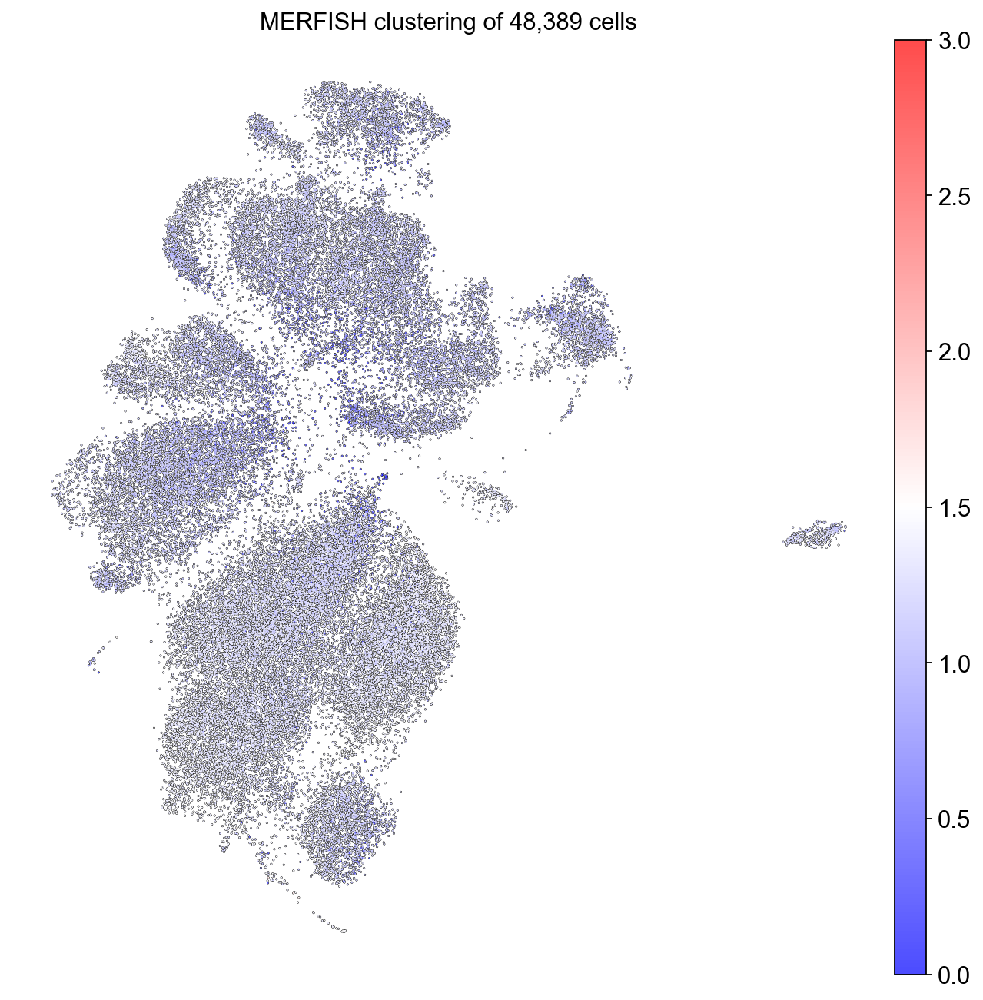

In [45]:
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata2,
    color=dic_gene_to_Q['Sall1'],#Mrc1,Tlr8
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
    frameon=False,
    title=f"MERFISH clustering of {len(scdata2):,d} cells",
    cmap='bwr',vmax=3#### log expression maximum
)

In [25]:
def plot_gene_expression(gene,dic_count=dic_count,
                         dic_cells_final=dic_cells_final,
                         bad_cells=[],vmax=None,vmax_perc=None,
                         name=None,bad_fovs=[]):
    cells = list(dic_count.keys())
    cells = [cell for cell in cells 
             if ((int(cell)//10**4 not in bad_fovs) and (cell not in bad_cells))]
    scores = [dic_count[cell][gene] for cell in cells]
    x,y = -np.array([dic_cells_final[cell]['X'][1:] for cell in cells]).T


    fig = plt.figure(figsize=(15,12), facecolor='black')
    if vmax is None and vmax_perc is None:
        vmax_ = 30
    if vmax_perc is not None:
        vmax_ = np.percentile(scores, vmax_perc)
    if vmax is not None:
        vmax_ = vmax

    plt.scatter(x, y, c=scores, s=0.5, cmap='coolwarm', vmax=vmax_)
    cb = plt.colorbar(shrink=0.5)
    if name is None:
        name = gene
    cb.ax.set_title(f'{name}\ncounts', color='white', fontsize='x-large', fontweight='heavy')
    cb.ax.yaxis.set_tick_params(color='black')
    cb.outline.set_edgecolor('w')
    plt.setp(plt.getp(cb.ax.axes, 'yticklabels'), color='white', fontsize='x-large', fontweight='heavy')
    plt.grid(b=None)
    plt.axis('off')
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

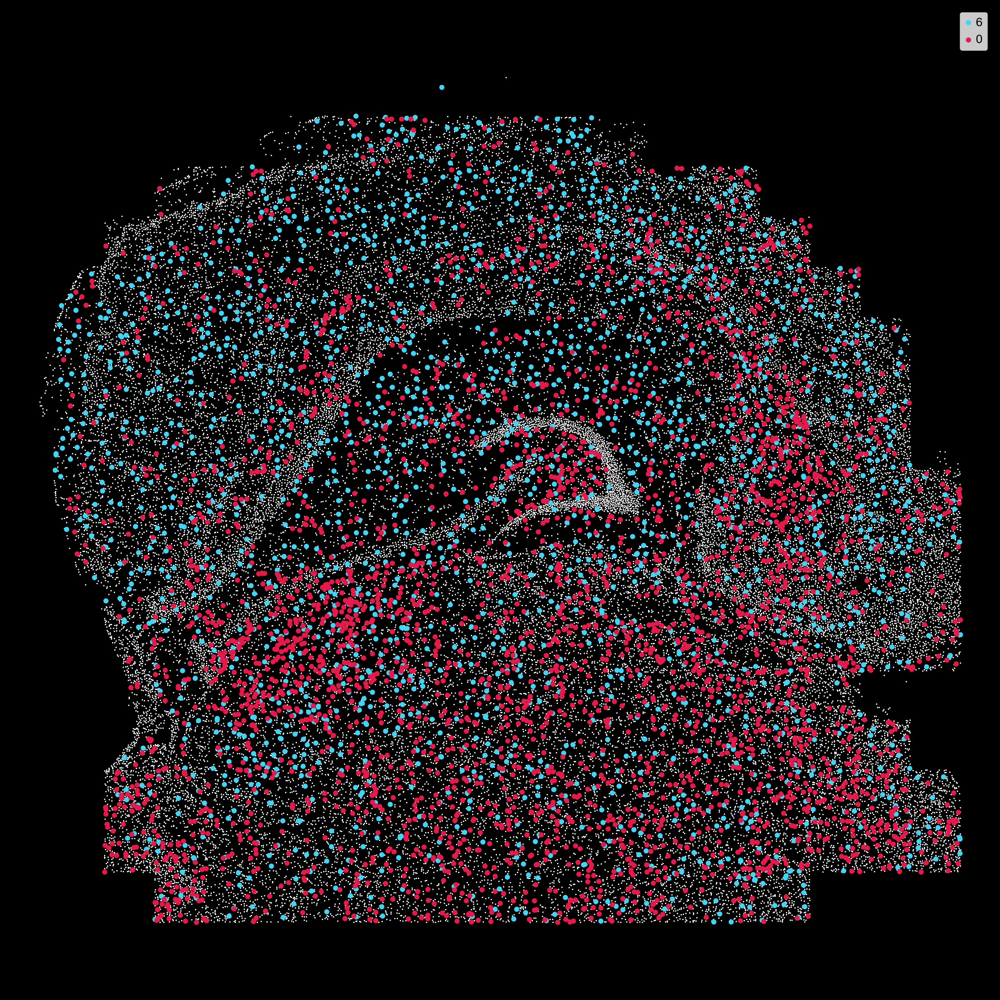

In [38]:
plt_clusters(clusters = ['6','0'])

In [27]:
genes_names=['Adarb2', 'Apod', 'Atp1a2', 'C1ql3', 'Cacnb2', 'Cald1', 'Camk2d', 'Camk2n1', 'Cdh18', 'Cnr1', 'Cst3', 'Cttnbp2', 'Dab1', 'Dcc', 'Dcn', 'Flt1', 'Fras1', 'Gad2', 'Hs3st2', 'Hs3st4', 'Il1rapl2', 'Kcnc2', 'Kcnq5', 'Mef2c', 'Meis2', 'Mt1', 'Ndnf', 'Ndst4', 'Nnat', 'Nos1', 'Nr4a2', 'Nrep', 'Ntng1', 'Ppfia2', 'Ptprd', 'Qk', 'Rbms3', 'Sgcd', 'Slc6a1', 'Sst', 'Tafa1', 'Tafa2', 'Trps1', 'Tshz2', 'Wfs1', 'Wipf3', 'Zbtb20', 'Zfpm2']
genes_namesG=['Alox5ap', 'Apoc1', 'Apoe', 'Axl', 'B2m', 'Ccl4', 'Cd33', 'Cd63', 'Cd74', 'Cd86', 'Cd9', 'Cebpa', 'Csf1', 'Csf1r', 'Cx3cr1', 'Cybb', 'Dab2', 'Egr1', 'F13a1', 'Frmd4a', 'Fth1', 'Gas6', 'H2-DMa', 'H2-K1', 'Hs3st1', 'Ier2', 'Ifitm3', 'Il1a', 'Inpp5d', 'Jun', 'Kif11', 'Klk8', 'Lyve1', 'Lyz2', 'Mki67', 'Mrc1', 'Mx1', 'Nav2', 'Nfkbia', 'P2ry12', 'Pacsin1', 'Pf4', 'Pla2g7', 'Plxdc2', 'Rara', 'Sall1', 'Spi1', 'Spp1', 'Tlr3', 'Tlr4', 'Tlr8', 'Tmem119', 'Top2a', 'Trem2', 'Tyrobp']


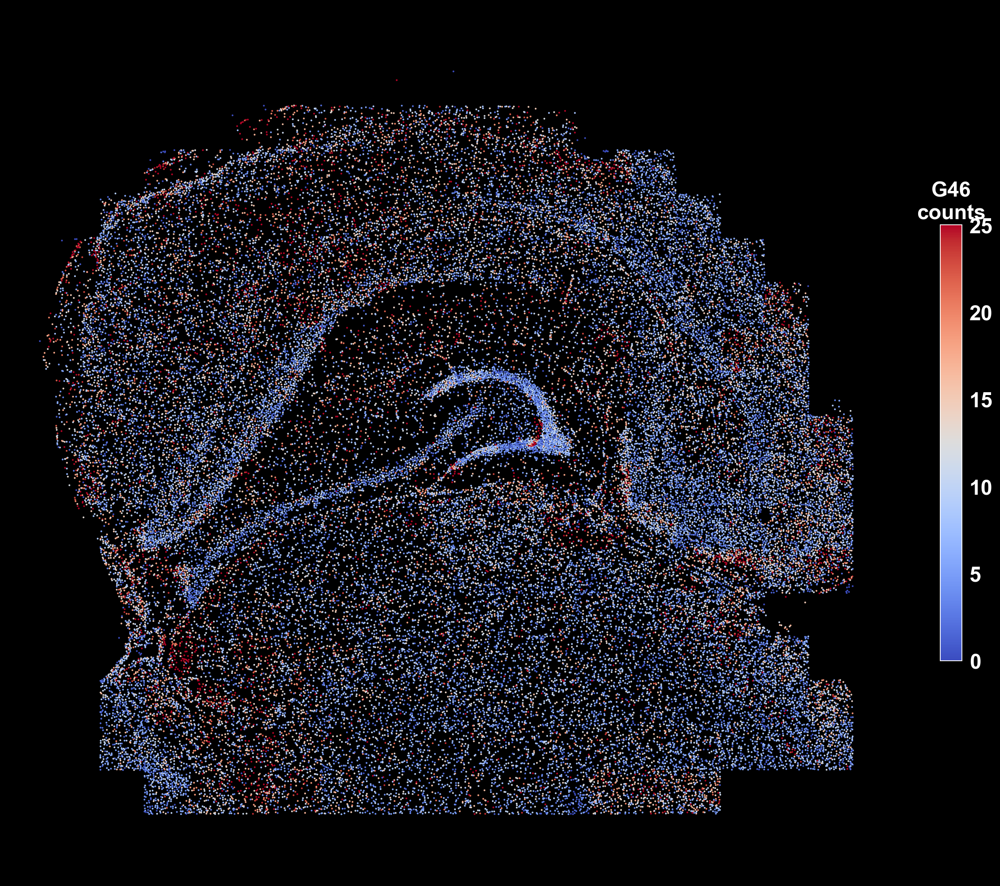

In [31]:
plot_gene_expression(dic_gene_to_Q['Sall1'],vmax=25)

In [39]:
cluster = '0'
zscores = Mzscore_fish[list(ulabel_fish).index(cluster),inds]
names = np.array(genes_seq)[inds]
inds2 = np.argsort(zscores)[::-1]
list(zip(names[inds2],zscores[inds2]))

[('Atp1a2', 2.5614269),
 ('Mt1', 2.4273877),
 ('Apoe', 2.193171),
 ('Pla2g7', 2.128437),
 ('Cst3', 1.3825678),
 ('Slc6a1', 1.3343835),
 ('Axl', 1.1756755),
 ('Tlr3', 0.8746246),
 ('Qk', 0.7073969),
 ('Trps1', 0.6343224),
 ('Zbtb20', 0.5346409),
 ('H2-K1', 0.34566453),
 ('Nnat', 0.296149),
 ('Sall1', 0.23091672),
 ('Fth1', 0.17095003),
 ('Ccl4', 0.031736165),
 ('Cd9', 0.0029653984),
 ('Csf1', -0.037882008),
 ('Tlr8', -0.050049517),
 ('Frmd4a', -0.06946363),
 ('Dab2', -0.13531025),
 ('Nfkbia', -0.1927616),
 ('Spp1', -0.22011347),
 ('Nrep', -0.24199592),
 ('Cebpa', -0.25514582),
 ('Camk2n1', -0.27430624),
 ('Apod', -0.28725207),
 ('Cx3cr1', -0.33667198),
 ('Trem2', -0.3378093),
 ('Flt1', -0.3413289),
 ('Cd74', -0.3591856),
 ('Tshz2', -0.37328735),
 ('Lyve1', -0.37683025),
 ('Sgcd', -0.38352993),
 ('Rara', -0.39242643),
 ('Mrc1', -0.42239553),
 ('Tmem119', -0.42725217),
 ('Meis2', -0.4369369),
 ('Kif11', -0.5152154),
 ('Wfs1', -0.5187989),
 ('Gad2', -0.5390504),
 ('Zfpm2', -0.5391886),
 ('

ValueError: 'cluster=6' is not one of the example datasets.

In [33]:
scdata2

AnnData object with n_obs × n_vars = 48389 × 103
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p', 'neighbors', 'leiden', 'umap', 'leiden_colors'
    obsm: 'X_spatial', 'X_raw', 'X_umap'
    obsp: 'distances', 'connectivities'